<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#One-Shot-Strategy:-1-Qubit" data-toc-modified-id="One-Shot-Strategy:-1-Qubit-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>One-Shot Strategy: 1 Qubit</a></span></li></ul></div>

# Quantum Amplitude Damping Channel

In [1]:
import os,sys,inspect
currentdir = os.path.dirname(os.path.abspath(inspect.getfile(inspect.currentframe())))
parentdir = os.path.dirname(currentdir)
sys.path.insert(0,parentdir) 

from qcd.dampingchannels import OneShotDampingChannel
from qcd.backends import SimulatorBackend, FakeSimulatorBackend, DeviceIBMQ
from qcd.configurations import OneShotSetupConfiguration
from qcd import save_object_to_disk, load_object_from_file
import numpy as np
import warnings
warnings.filterwarnings('ignore')

## One-Shot Strategy: 1 Qubit

In [4]:
one_qubit_channel = OneShotDampingChannel(
    channel_setup_configuration = OneShotSetupConfiguration({
        'points_theta': 20,
        'points_phase': 10,
        'attenuation_angles': np.append(np.arange(0, np.pi/2, np.pi/2/20), np.pi/2)}))

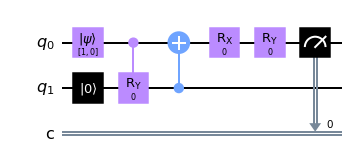

In [5]:
one_qubit_channel.plot_first_channel()

In [19]:
one_qubit_results = one_qubit_channel.run(backend = SimulatorBackend())

Execution using channel with λ=0.0 launched to qasm_simulator with id=87949435-bab1-4df1-a830-c806be12cc5f
Execution using channel with λ=0.5 launched to qasm_simulator with id=be0f2b9f-b178-4e06-8c1c-70c821e544bc
Execution using channel with λ=1.0 launched to qasm_simulator with id=83867e08-85af-4ea9-8755-8ed32607b2cb


In [20]:
save_object_to_disk(one_qubit_results, name='20210420_one_qubit_results__', path='results/')

In [2]:
loaded_one_qubit_results = load_object_from_file(name='20210420_one_qubit_results', path='results/')

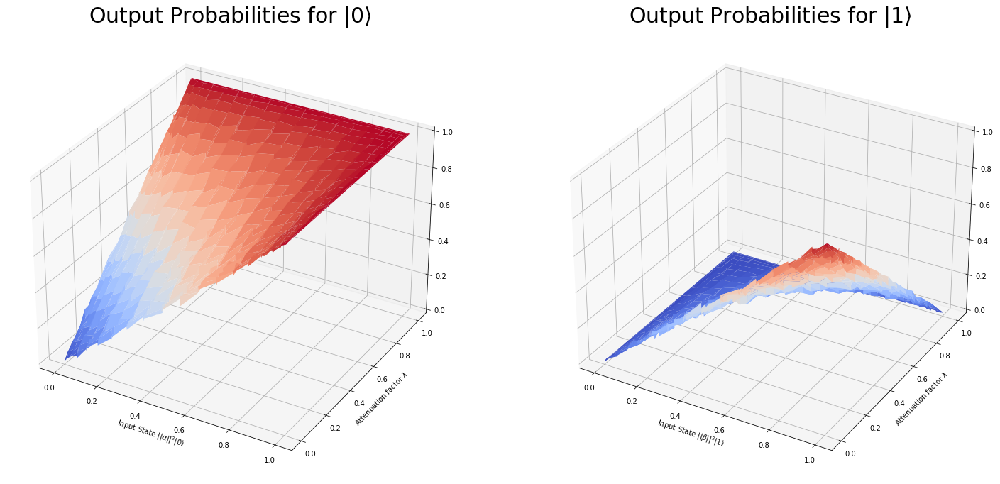

In [6]:
loaded_one_qubit_results.plot_surface_probabilities()

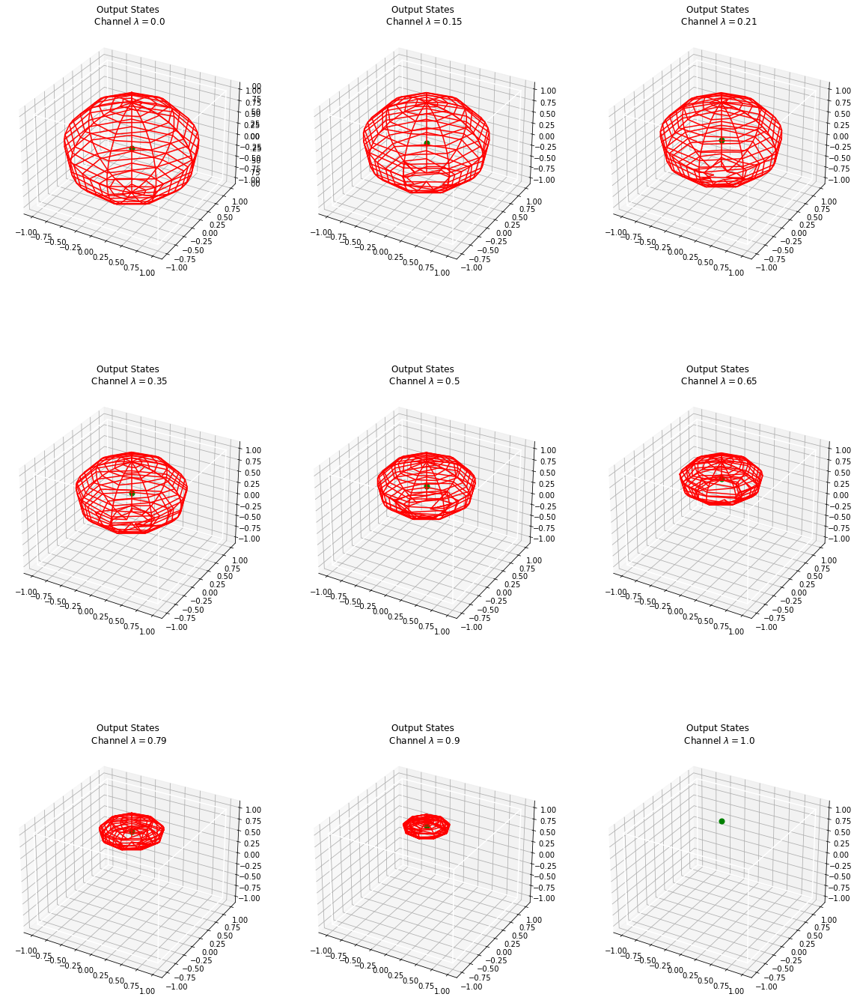

In [3]:
loaded_one_qubit_results.plot_wireframe_blochs()

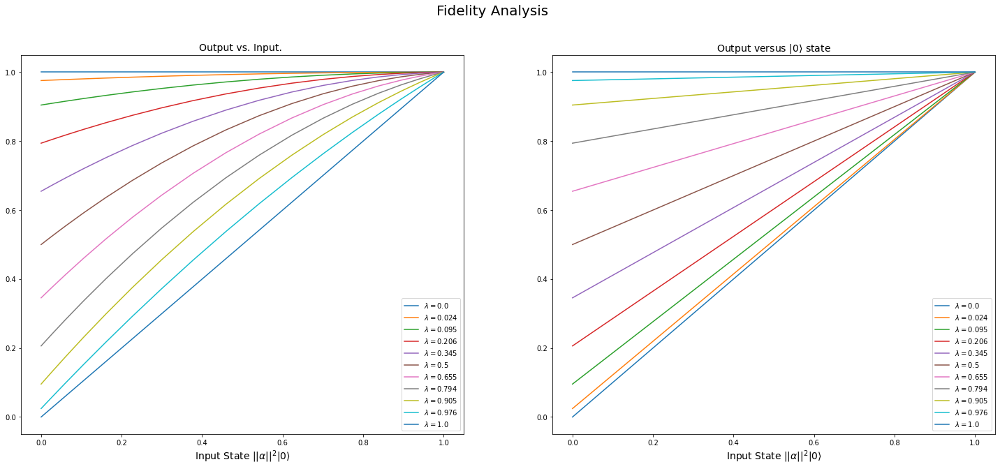

In [7]:
one_qubit_channel.plot_fidelity()

In [14]:
noisy_channel = OneShotDampingChannel(
    channel_setup_configuration = OneShotSetupConfiguration({ 
        'points_theta': 10,
        'points_phase': 7,
        'attenuation_angles': [np.pi/4]}))

In [17]:
noisy_results = noisy_channel.run(backend = [SimulatorBackend(), FakeSimulatorBackend(), DeviceIBMQ()])

Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=b0f9f245-9091-410d-9f11-e79bf1f3e4f2
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=1a14e46a-3f94-4da7-9f55-226d7987503f
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2814c41c143153a9e828


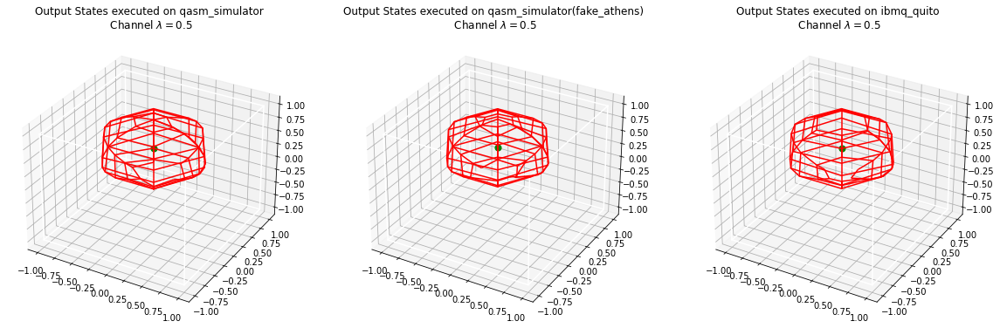

In [18]:
noisy_results.plot_wireframe_blochs_one_lambda()

In [ ]:
save_object_to_disk(noisy_results, name='20210420_noisy_results', path='results/')

In [19]:
second_noisy_results = noisy_channel.run(backend = [SimulatorBackend(), FakeSimulatorBackend(), DeviceIBMQ()])

ibmqfactory.load_account:WARNING:2021-04-20 21:15:02,744: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=7c4f93ff-2f1e-45f1-a4fb-06733cdf2696
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=c3cfad06-0c48-4174-85f9-46203bef9752
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f285d088c800ec00b024b


KeyboardInterrupt: 

In [ ]:
second_noisy_results.plot_wireframe_blochs_one_lambda()

In [ ]:
save_object_to_disk(second_noisy_results, name='20210420_second_noisy_results', path='results/')

In [20]:
def run_three_executions(idx: int):
    noisy_channel = OneShotDampingChannel(
    channel_setup_configuration = OneShotSetupConfiguration({ 
        'points_theta': 10,
        'points_phase': 7,
        'attenuation_angles': [np.pi/4]}))
    noisy_results = noisy_channel.run(backend = [SimulatorBackend(), FakeSimulatorBackend(), DeviceIBMQ()])
    noisy_results.plot_wireframe_blochs_one_lambda()
    save_object_to_disk(noisy_results, name=f'20210420_noisy_results_{idx}', path='results/')

ibmqfactory.load_account:WARNING:2021-04-20 21:21:11,747: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=198ef680-fd6c-4162-9bc8-ec4e73bfe228
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=bc4160b6-7dae-4ce0-b527-606fb023b8a8
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f29cfd2bccb2c5100c8d8


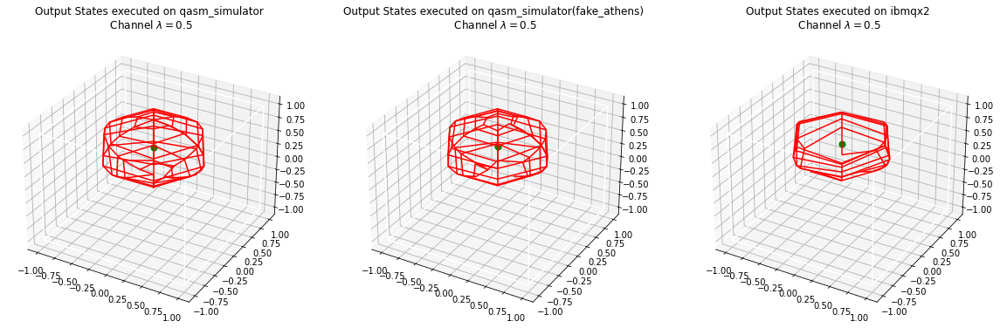

ibmqfactory.load_account:WARNING:2021-04-20 21:23:32,350: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=b4779273-65d7-41c0-a099-402acd72a1b0
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=a8c43726-712a-4c1a-8caa-482f3e2817ab
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f2a5fc41c14dceda9e83b


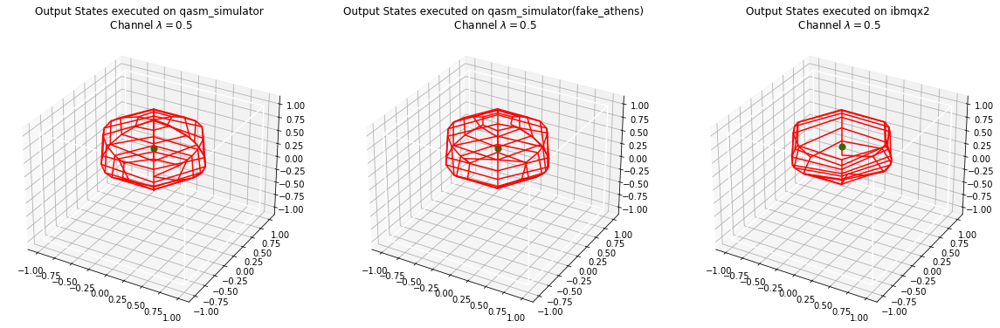

ibmqfactory.load_account:WARNING:2021-04-20 21:25:19,673: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=f4cf9df4-00ef-42a2-be3a-ca1d222eab64
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=429f7789-a467-4fe0-bb31-a291adb18096
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f2ac8adaee22ced76d307


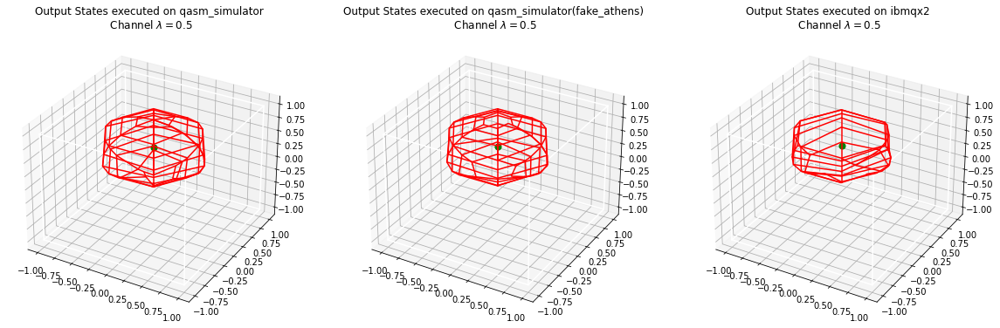

ibmqfactory.load_account:WARNING:2021-04-20 21:26:35,802: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=eb861819-9d47-4049-85b7-507e51bc0711
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=8ce90264-8aed-472b-ba34-64469a93052e
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f2b133bca0b67193793f6


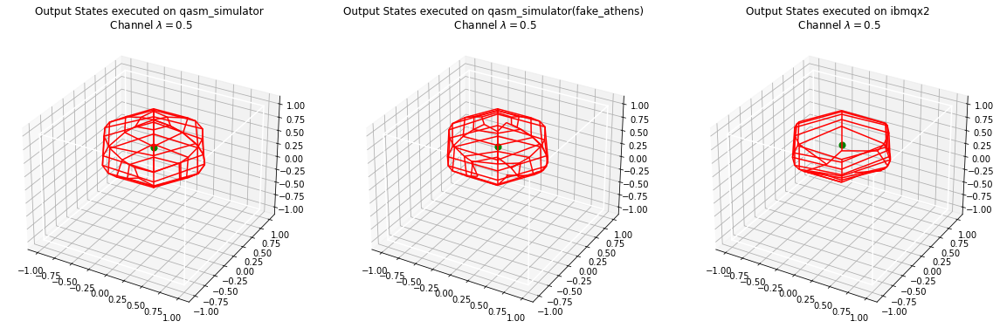

ibmqfactory.load_account:WARNING:2021-04-20 21:27:48,916: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=438a6c7d-42db-4e7a-ae20-b030bf1076dd
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=7c254e2f-4cdc-44c3-a286-2ce6dc02b023
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f2b5ed2bccb7d8b00c8e2


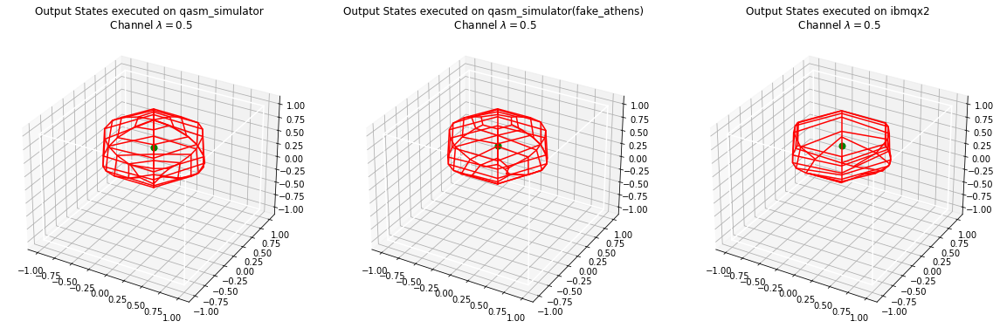

ibmqfactory.load_account:WARNING:2021-04-20 21:29:07,516: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=acbd73fd-344f-4ca8-8c89-c123f6f5dcb6
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=b7798703-1ce1-4902-a2b2-3f043653be29
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f2ba9adaee21a2876d30b


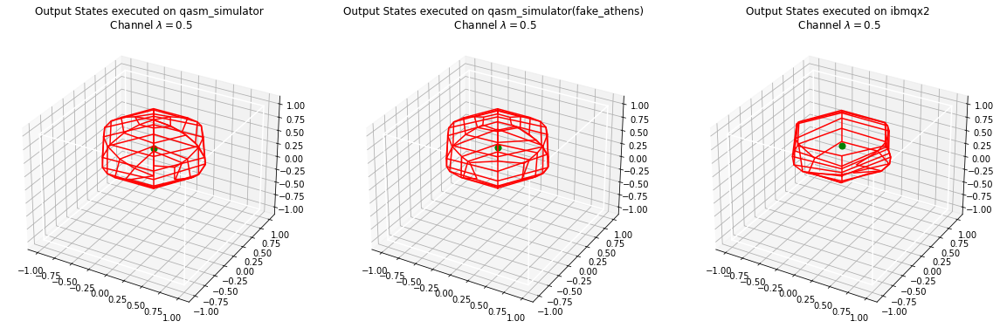

ibmqfactory.load_account:WARNING:2021-04-20 21:30:22,754: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=b6d95e46-d7e6-4364-8a39-d3422ef5bb90
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=4685fe8a-e679-44af-a1ea-79227b0a20cf
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2bf063b107e8efb57b47


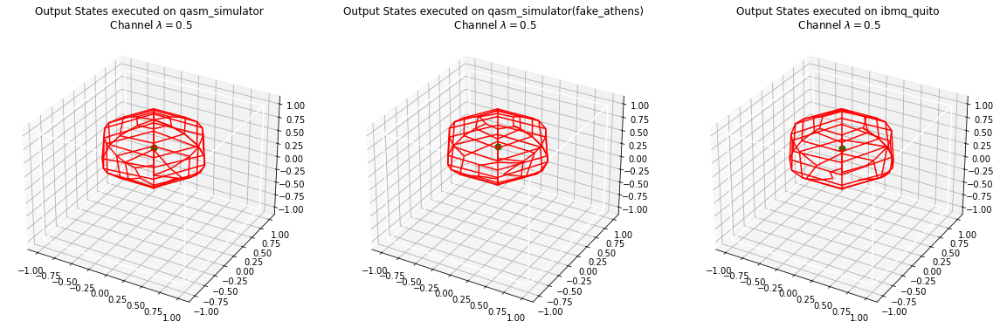

ibmqfactory.load_account:WARNING:2021-04-20 21:31:53,120: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=542fd670-c2f9-415d-a291-136dba4a80ce
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=717c5fb1-4c12-493f-a4e6-715581e9c320
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2c4d3bca0bfc393793fc


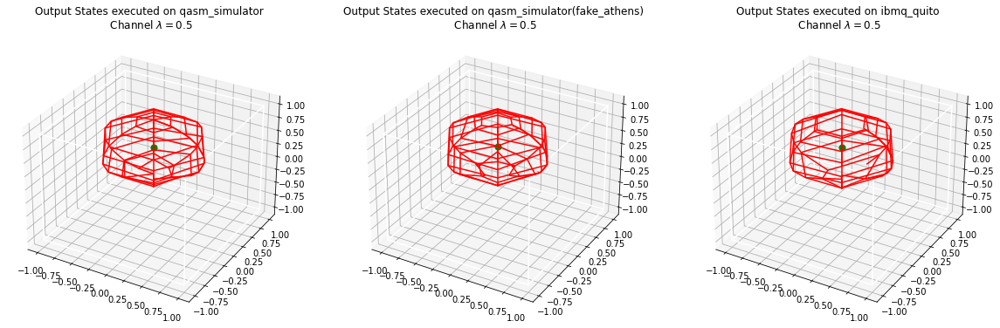

ibmqfactory.load_account:WARNING:2021-04-20 21:33:29,016: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=7a19bcb6-4bae-4964-a763-9af6498e7fde
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=e7d0b3f1-f675-4fd8-aa98-b637b46d3dd9
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2cacd2bccb5a8300c8eb


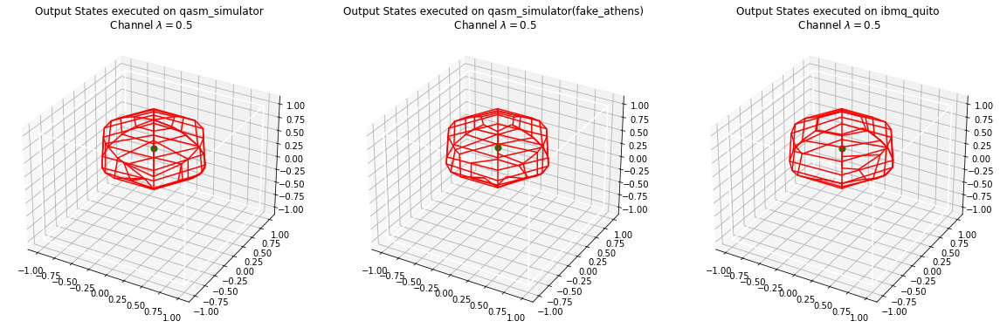

ibmqfactory.load_account:WARNING:2021-04-20 21:36:28,617: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=72e6e1b7-8062-4d84-b513-3c1824878604
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=62571766-6535-44e4-89ec-d6d4a5224843
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2d613bca0b81dd379407


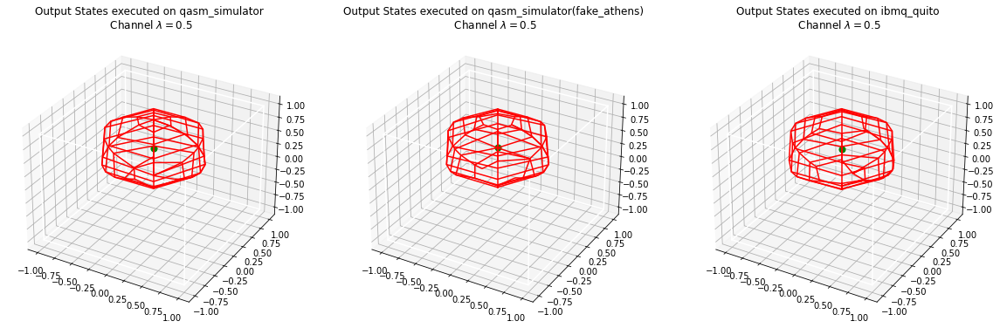

ibmqfactory.load_account:WARNING:2021-04-20 21:40:12,063: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=fb99a671-8e6c-4916-8576-e9e3056ca7af
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=8a1f73aa-7c5c-475f-906b-4fa7c0dd9767
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2e3f3bca0b864f379411


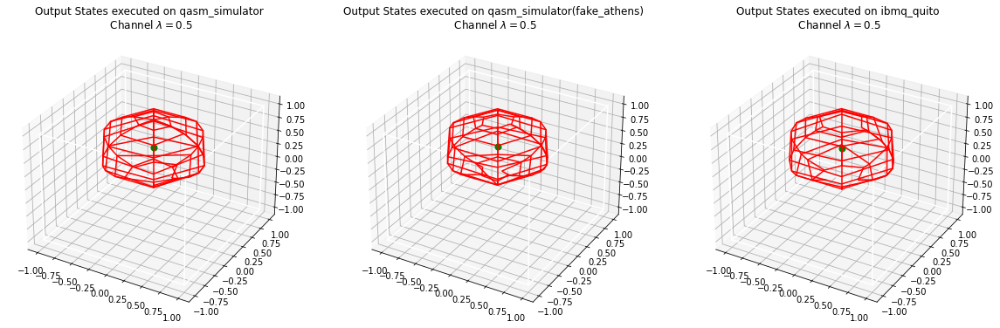

ibmqfactory.load_account:WARNING:2021-04-20 21:43:10,175: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=4f4fdc8d-d950-42ce-af6d-aff442f46c99
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=bfee453b-86f9-4072-aa13-ecf179bb1ce1
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2ef263b107afd4b57b63


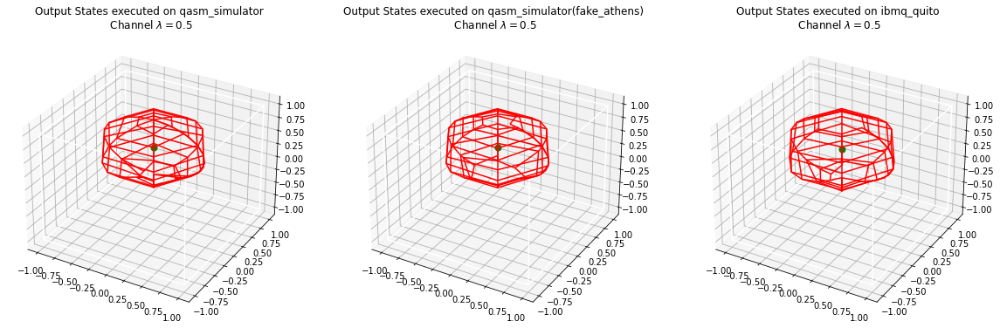

ibmqfactory.load_account:WARNING:2021-04-20 21:46:25,297: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=8c489a41-9176-4535-8a6b-06260a0b664f
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=cc2d9709-79f2-4f31-ab17-5f9815756396
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f2fb588bc93138307b59d


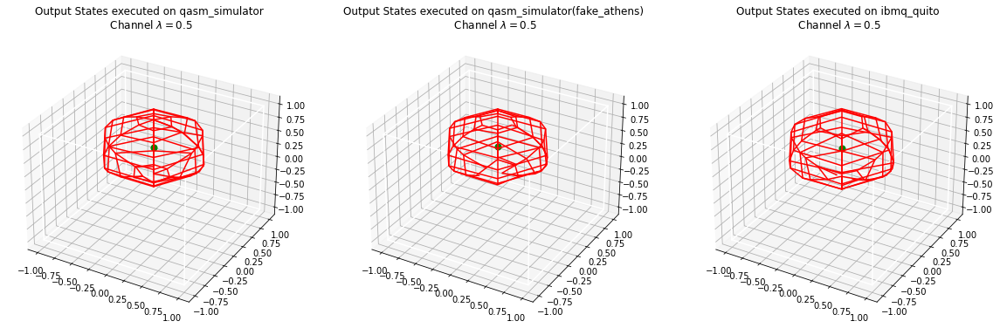

ibmqfactory.load_account:WARNING:2021-04-20 21:48:14,263: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=89f66882-30de-46b1-8446-f425fd3ce4cc
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=7d36c035-9700-49e4-8383-c7d7ba89ede9
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f302188bc931e5e07b5a1


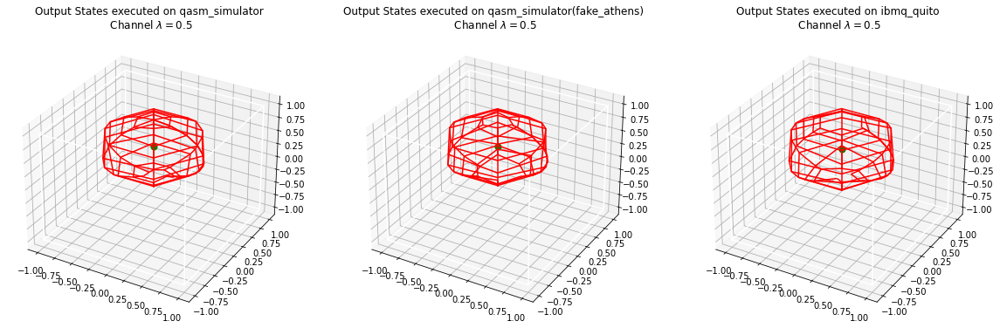

ibmqfactory.load_account:WARNING:2021-04-20 21:50:07,137: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=edbfc9cf-46dc-48ec-b5cb-226c8504b713
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=aad736f4-0636-4faa-9863-906ceef1c482
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f3092adaee2099d76d334


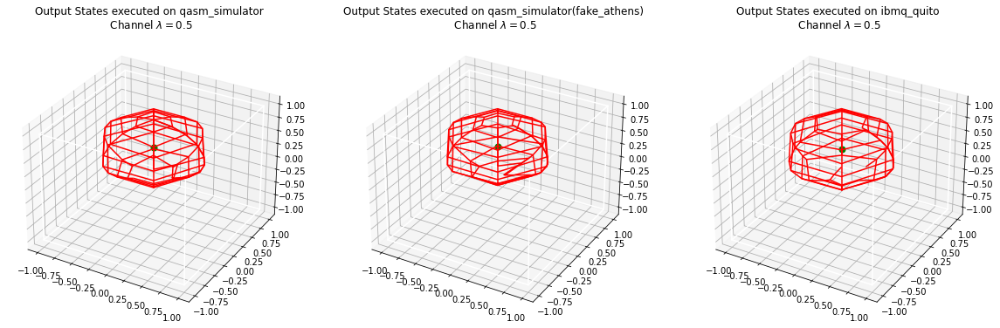

ibmqfactory.load_account:WARNING:2021-04-20 21:53:24,829: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=cc32d37d-552d-4816-a286-337442cf24af
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=28f60175-3739-4d7c-9a2e-40562aef9fd7
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f315c88bc93841e07b5ad


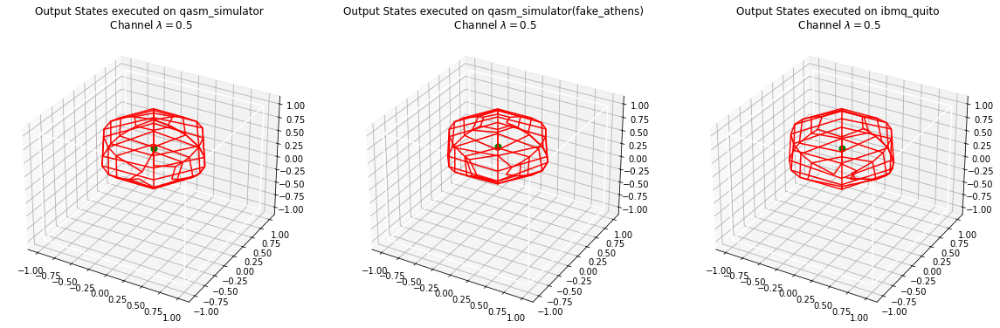

ibmqfactory.load_account:WARNING:2021-04-20 21:55:56,818: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=e2b3b9ac-dc05-4d69-b419-0907eb58b5b2
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=db42bbfb-e550-46d3-80cc-68f3a79d311d
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f31f3045f6cc80dfdd529


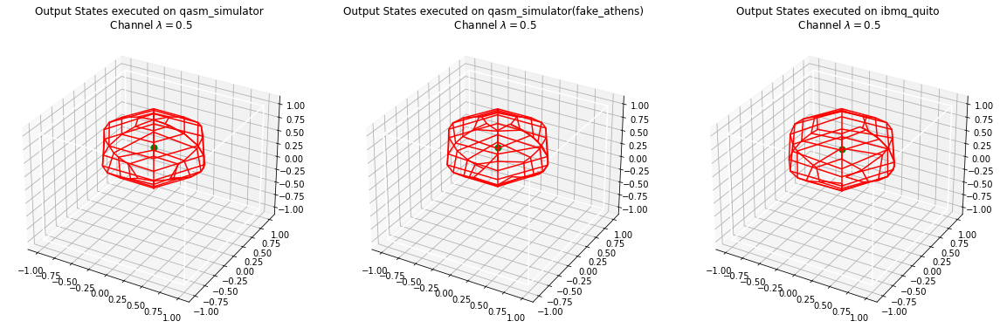

ibmqfactory.load_account:WARNING:2021-04-20 21:57:11,469: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=cc9c4fe1-d4ae-492e-a188-7d62ec5b3d47
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=6632a5bf-ccae-46bf-946c-4b3230549582
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f323a88bc934c8a07b5b2


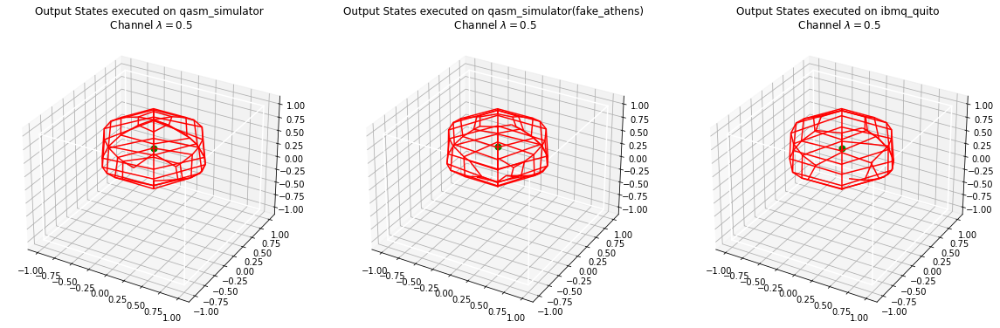

ibmqfactory.load_account:WARNING:2021-04-20 21:58:20,935: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=a3ea9ff7-bb0a-488c-805a-1200517443c1
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=be3fd40a-8bf7-4fab-b75b-931ce7c26bcd
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f3284045f6c1384fdd52e


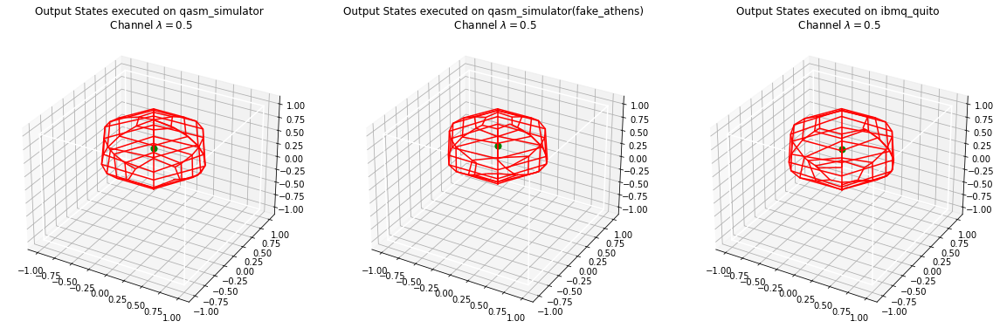

ibmqfactory.load_account:WARNING:2021-04-20 22:01:50,309: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=6329c88f-2593-4cdc-b535-1c7a24eca953
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=9c15c5e6-7bc4-412a-b11a-862f722785bc
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f335263b10717dab57b88


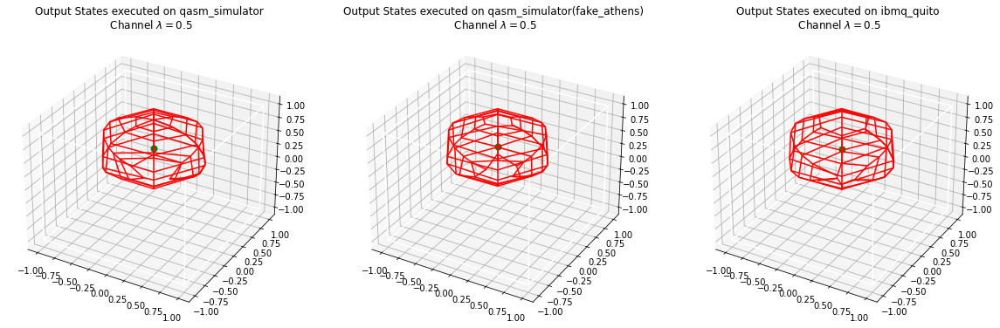

ibmqfactory.load_account:WARNING:2021-04-20 22:03:02,072: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=0ecbc039-252d-4db5-b83f-983fa8217939
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=f4068a74-7ec8-46ce-8317-f4b281650047
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f3398088c8020030b029f


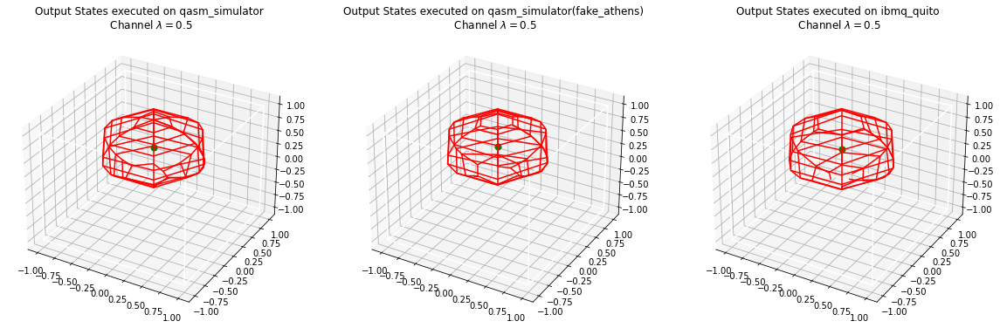

ibmqfactory.load_account:WARNING:2021-04-20 22:04:10,432: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=6c6fa551-188a-4f58-a285-ae119d730de3
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=4e7e5bc2-3ae8-4a01-9438-d506d1dffb14
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f33de667b248769cfb318


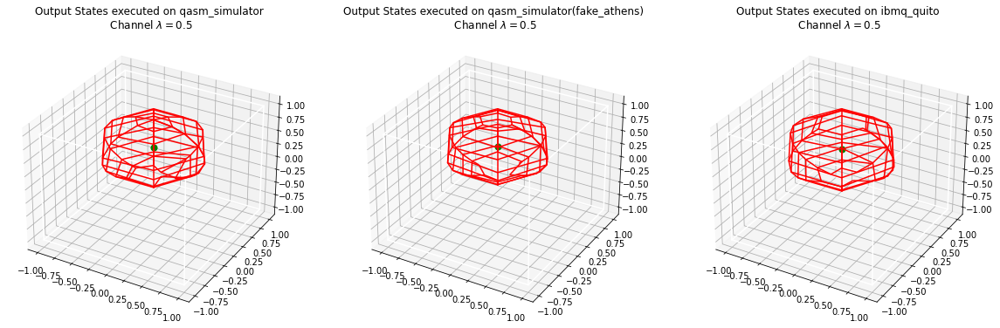

ibmqfactory.load_account:WARNING:2021-04-20 22:05:57,256: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=e64dbdab-22bf-4d5c-8417-bdf8ba2e2981
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=0fc94a2c-611b-4fce-adfb-f1b874dddb0f
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f344ad2bccbd0dd00c929


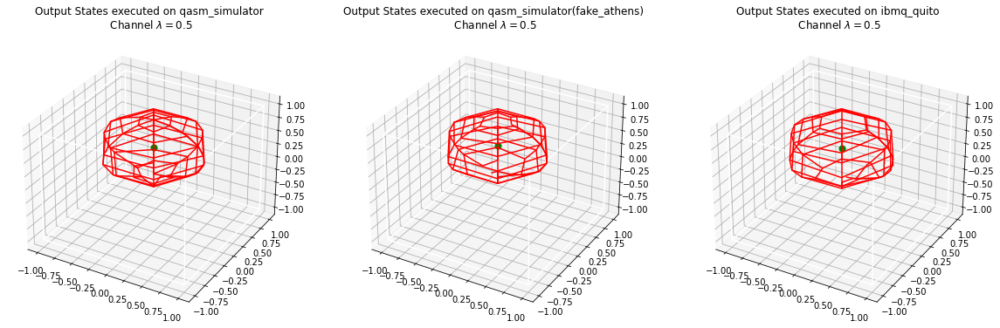

ibmqfactory.load_account:WARNING:2021-04-20 22:08:32,653: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=86f2b1db-8aa7-42df-a186-2673b939597a
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=171df498-3f36-4e4c-b8f2-77b9cd6cf9e2
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f34e613b2440518c01a29


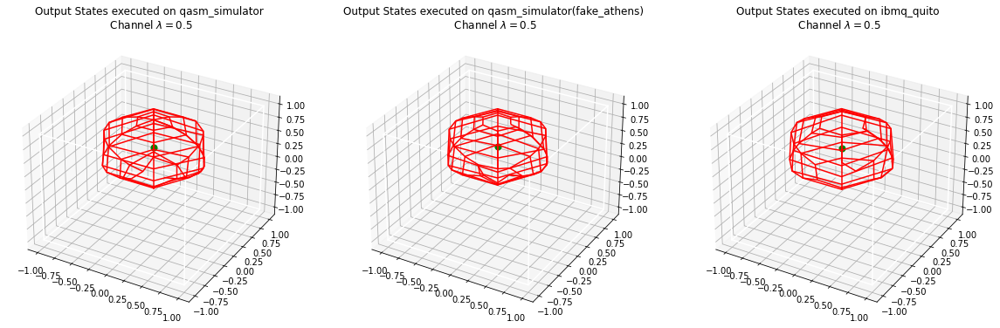

ibmqfactory.load_account:WARNING:2021-04-20 22:09:43,508: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=ce1f8779-e4f6-4182-a6e2-c9dcd926fcbd
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=64473ece-a849-42ba-b2f5-2a60bc6f27c7
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f352988bc932b0907b5d1


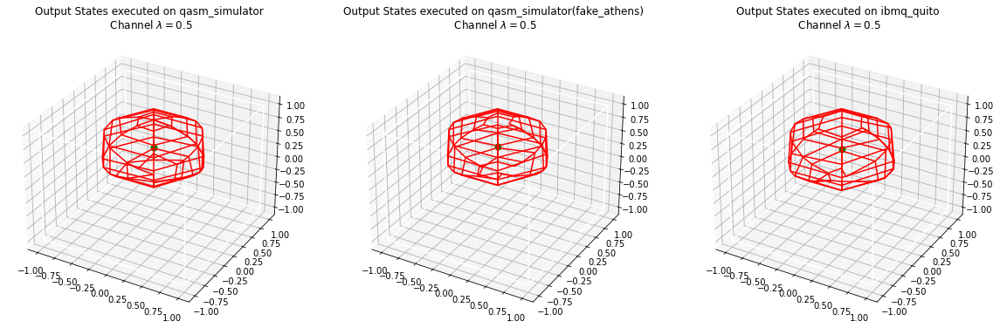

ibmqfactory.load_account:WARNING:2021-04-20 22:13:36,677: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=16fdebab-0b65-4942-91da-78a02ae56435
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2a7c28d7-a247-446f-86d7-8b11d1d25505
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f361313b2447964c01a32


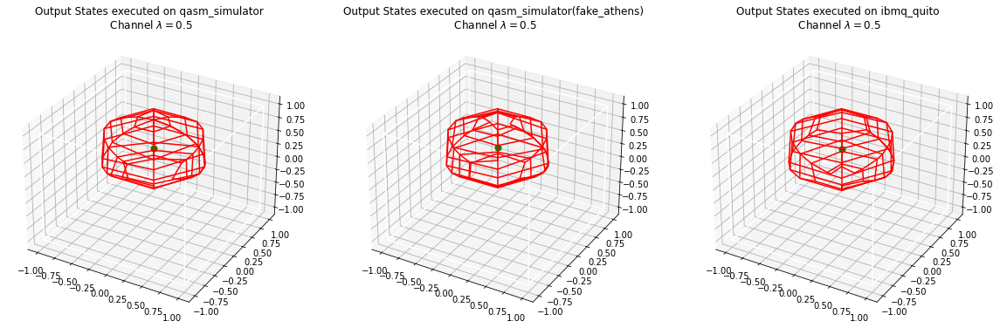

ibmqfactory.load_account:WARNING:2021-04-20 22:15:26,361: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=59b71b31-2372-444c-b0ae-8cbfc25a1892
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2dca4c07-a7e5-492a-85dd-f1722c00bba2
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f3683088c8052c00b02c3


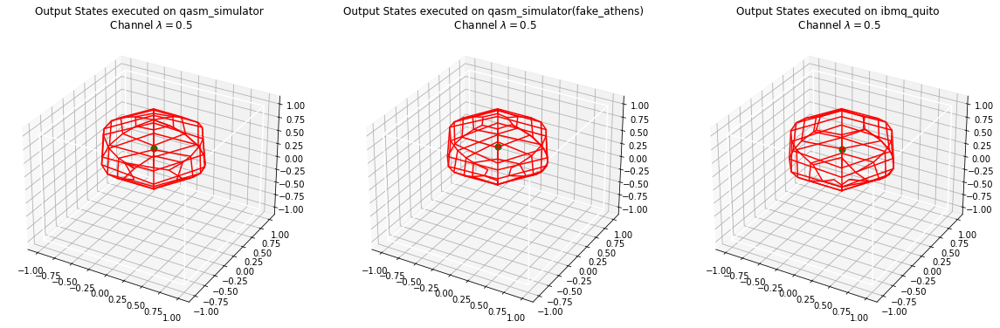

ibmqfactory.load_account:WARNING:2021-04-20 22:18:09,574: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=89785022-75e0-44a5-b2a9-f81b1628084f
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=87d8d5da-137b-4abb-aeb5-fc006a069695
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f372a045f6c1711fdd55a


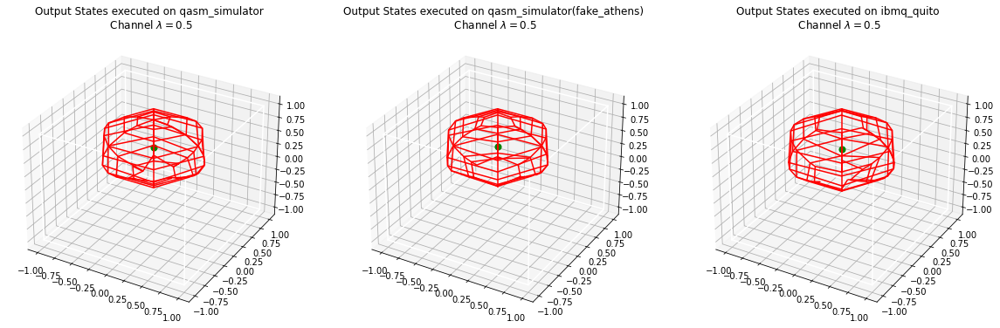

ibmqfactory.load_account:WARNING:2021-04-20 22:21:07,785: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=e63f615b-abf7-4978-af7b-92adaaf5c47d
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=0143e5ba-b2b6-4f69-90ef-c518db5c8c28
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f37d6adaee275c676d371


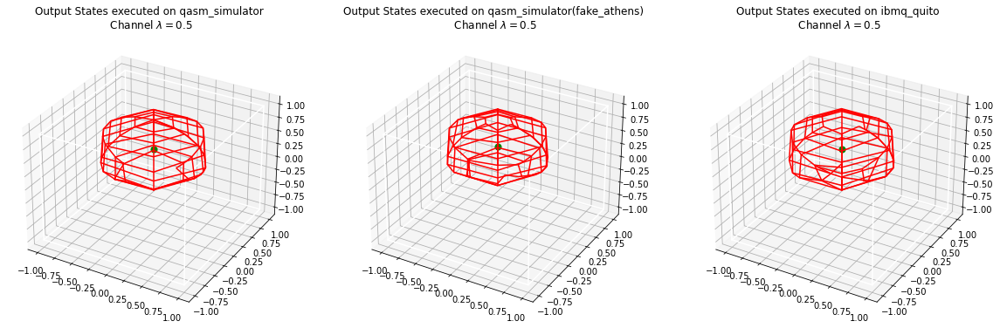

ibmqfactory.load_account:WARNING:2021-04-20 22:23:25,479: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=d09ece95-799b-4bc8-8315-1c1bb82350a1
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=a2e5d2c9-5eb7-4c92-ba79-deb320a16a7f
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f3861adaee201f676d377


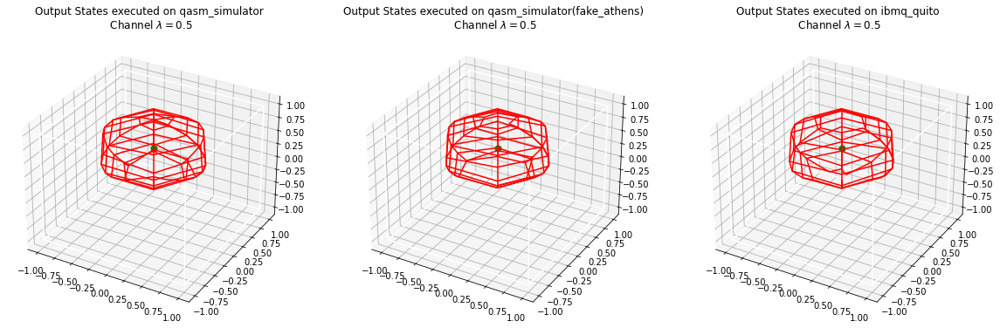

ibmqfactory.load_account:WARNING:2021-04-20 22:24:34,393: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=551fdf11-f410-4871-b022-2cc4db50a8dd
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=602f0bde-94f5-4b94-9f51-7c49eb3787b5
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f38a7667b247e80cfb33d


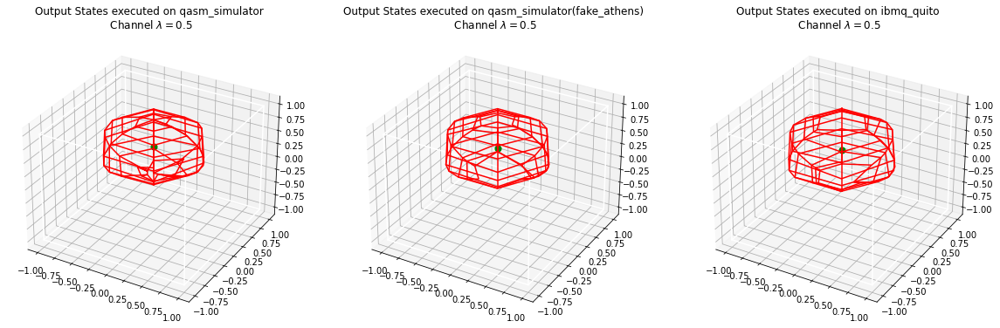

ibmqfactory.load_account:WARNING:2021-04-20 22:25:45,011: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=93f6c913-103a-4bf7-b580-886d81ca2153
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=573fa799-230c-4488-a05a-28f2edf14da4
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f38eec41c14835ca9e8ad


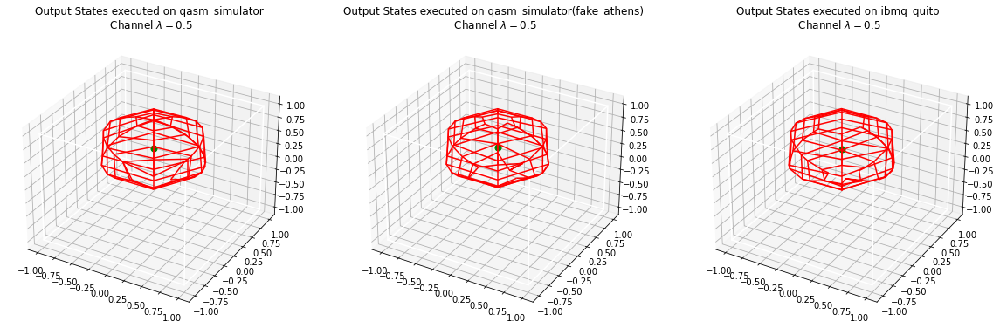

ibmqfactory.load_account:WARNING:2021-04-20 22:29:46,478: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=a0bc1c79-2583-4667-9e25-04fba4782063
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=4893c0e3-84d1-423a-88e3-ada012f74a62
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f39de045f6ce1e7fdd570


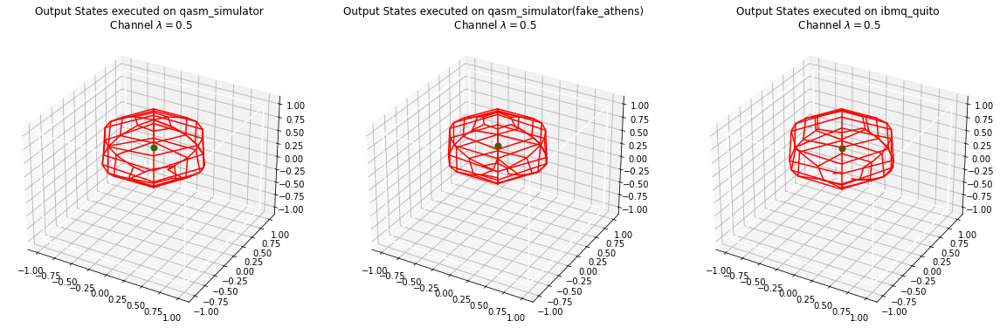

ibmqfactory.load_account:WARNING:2021-04-20 22:32:56,550: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=ee842239-2325-4373-9b44-26e8fde6b71b
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=4e6622a8-5adb-41ac-b587-aad963d5c13a
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3a9badaee251d676d386


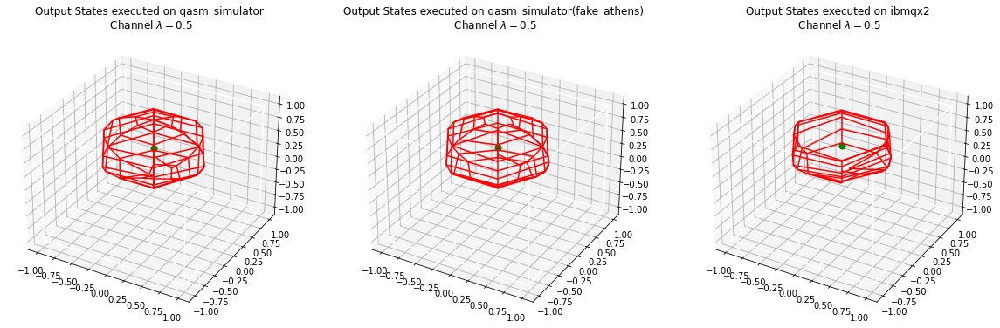

ibmqfactory.load_account:WARNING:2021-04-20 22:34:08,911: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=364fa235-d0e7-4249-88be-7a8ade456c89
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=bab5a107-4fa3-462f-9881-84b8e1fe8ff9
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3aeaadaee2e52376d38a


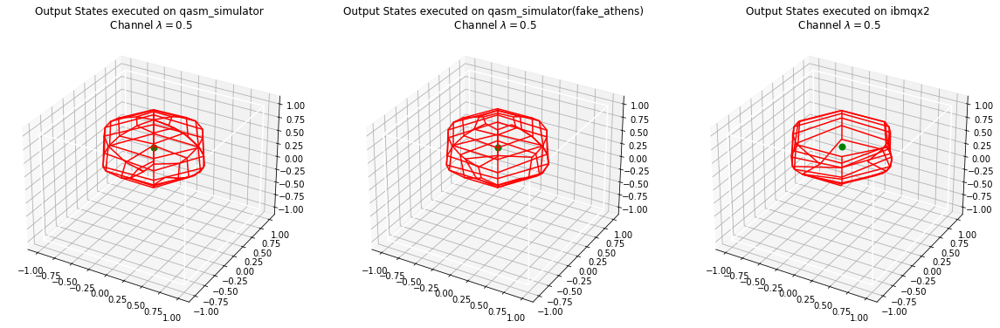

ibmqfactory.load_account:WARNING:2021-04-20 22:35:25,525: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=2e122904-43f0-41fc-9d80-2062d74da4e9
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=70d5af55-1680-49e8-be19-bc1ed29e5cd2
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3b38088c802b370b02ec


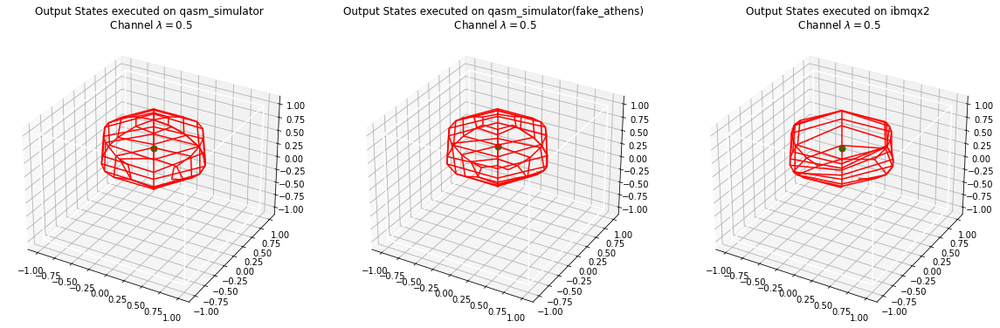

ibmqfactory.load_account:WARNING:2021-04-20 22:36:41,691: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=98f14383-8bef-4749-9f42-e9821d64bc98
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=9b837f5f-99e6-4399-b920-be50505b2688
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3b7d667b247dfecfb352


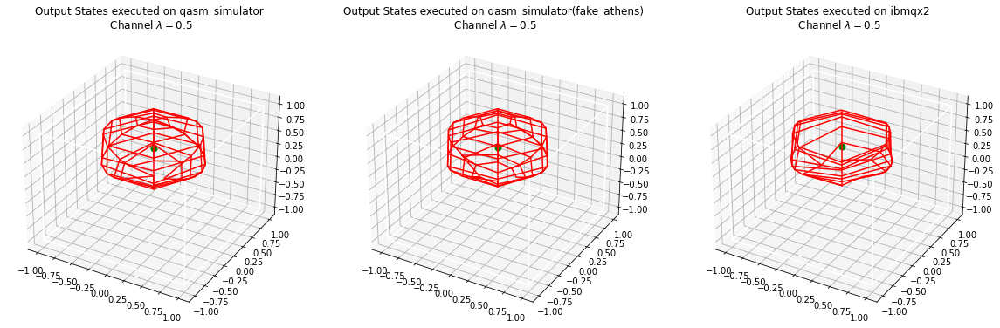

ibmqfactory.load_account:WARNING:2021-04-20 22:37:50,961: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=7a0e6b49-54df-4ae4-887e-c469ff39916d
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=11cb8b25-d684-4954-9a59-d13bfe936ca1
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3bc6d2bccb526b00c963


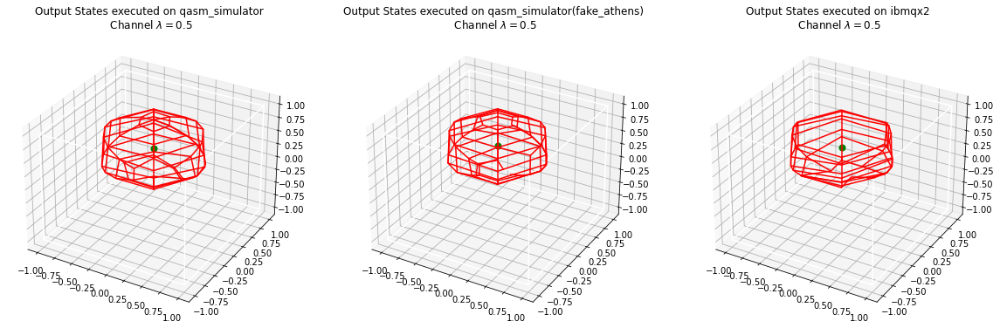

ibmqfactory.load_account:WARNING:2021-04-20 22:39:03,704: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=1dc25e03-670f-49f1-86b3-9c818740049d
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=4859b46d-4a52-4d59-84b0-309ba3455652
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3c1163b1075dfab57bd9


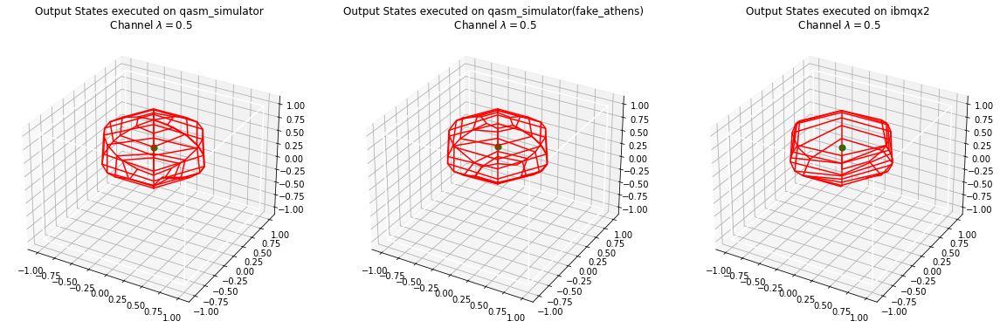

ibmqfactory.load_account:WARNING:2021-04-20 22:40:17,415: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=9639a8c3-0329-488b-9832-e31b1cf28a03
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=4f525047-d244-44c4-8c52-efa77a08519d
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3c5488bc93defc07b606


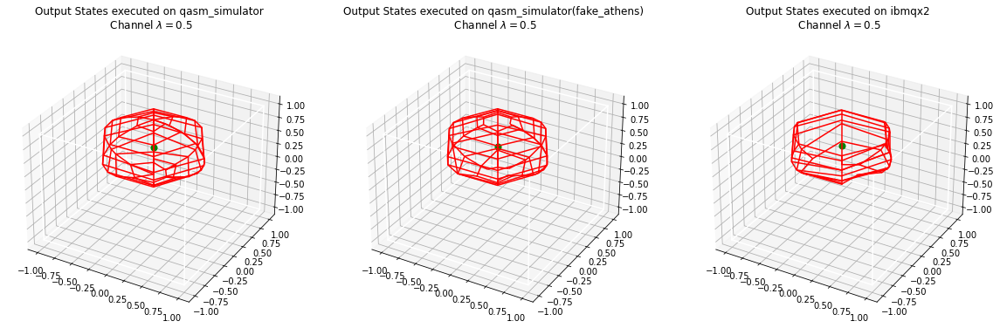

ibmqfactory.load_account:WARNING:2021-04-20 22:41:25,284: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=7393915a-6cee-42b4-bfe9-b4048a5d3ae8
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=d003fe3e-95fb-43f9-a9f4-031a49e63740
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3c983bca0bdd8d379493


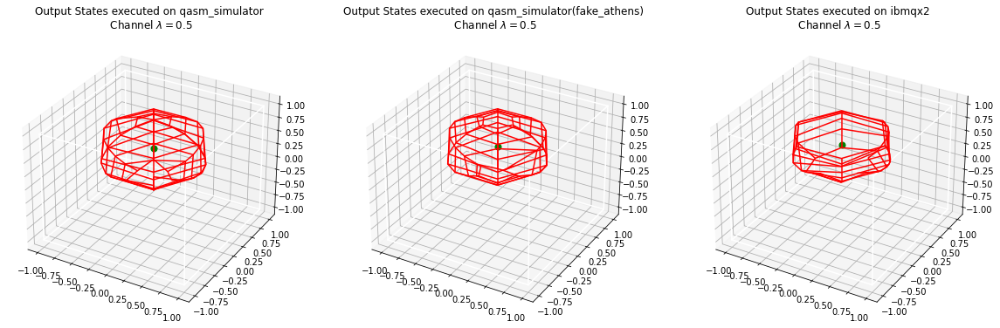

ibmqfactory.load_account:WARNING:2021-04-20 22:42:35,210: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=0e68e934-a1b3-4e57-9488-825e69206f6d
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=5bcc26e5-fdf7-4f75-ab5e-39f6845313fb
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3cdfc41c14914aa9e8d3


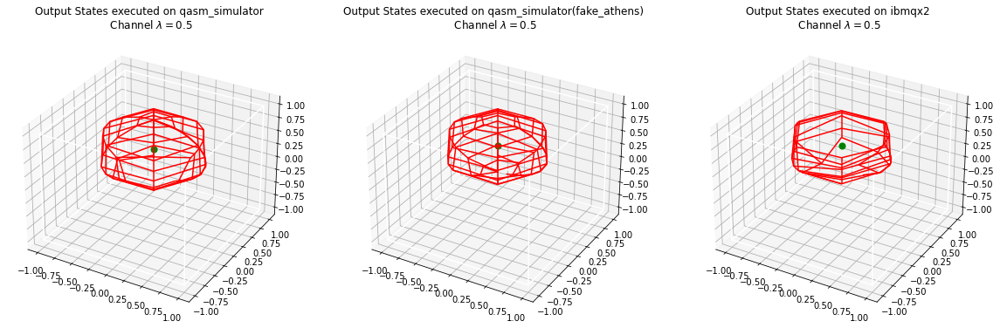

ibmqfactory.load_account:WARNING:2021-04-20 22:43:46,457: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=abab3aae-3e45-4a1d-b033-923d5781a958
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=5ecd3c28-80b7-42af-a5b7-ea458faf1d8c
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3d2613b24412e7c01a6e


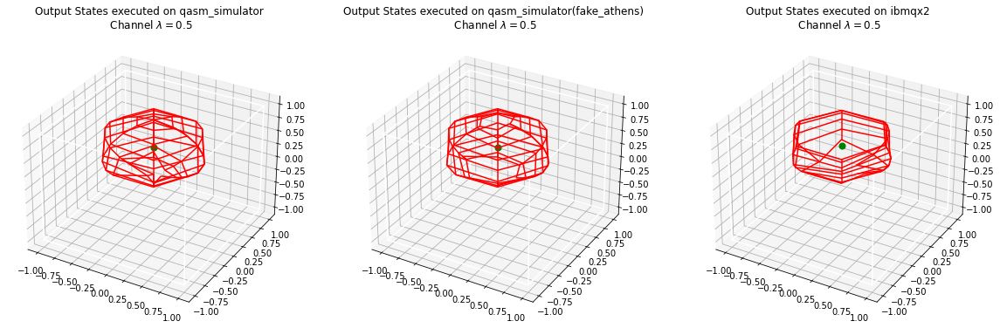

ibmqfactory.load_account:WARNING:2021-04-20 22:44:55,262: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=16ea9829-0250-404a-b2fd-1ad0e398fc22
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=585fd6b6-efa8-4079-b6ad-7af0c17b06ef
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3d70d2bccb51a600c96e


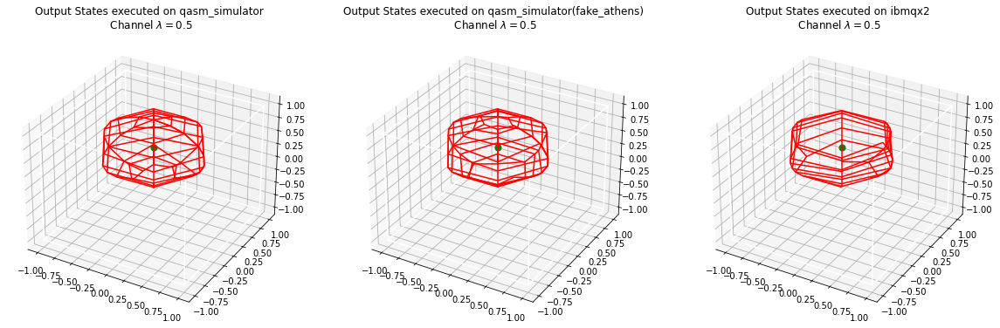

ibmqfactory.load_account:WARNING:2021-04-20 22:46:17,609: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=870297f9-fb62-487a-b42d-290637d27eab
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=7943400e-a37f-428b-8f28-e26c3b02a582
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3dbe88bc93727007b613


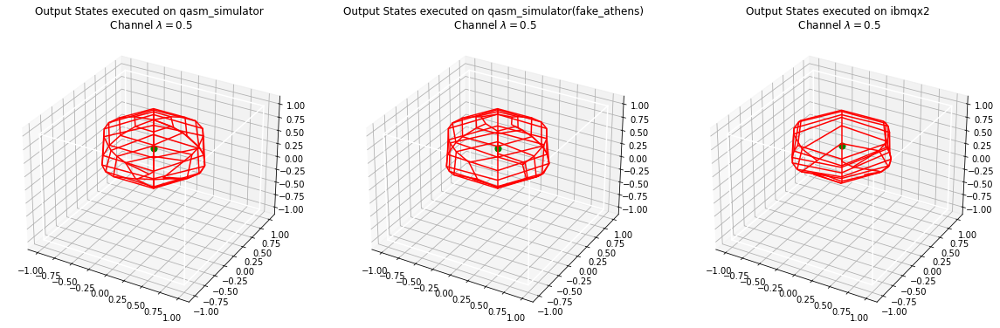

ibmqfactory.load_account:WARNING:2021-04-20 22:47:26,907: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=8a7d7307-75c4-419f-a057-da11a9103712
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=b6d54401-fbe0-4d42-b01d-5787b4975638
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3e063bca0ba83337949a


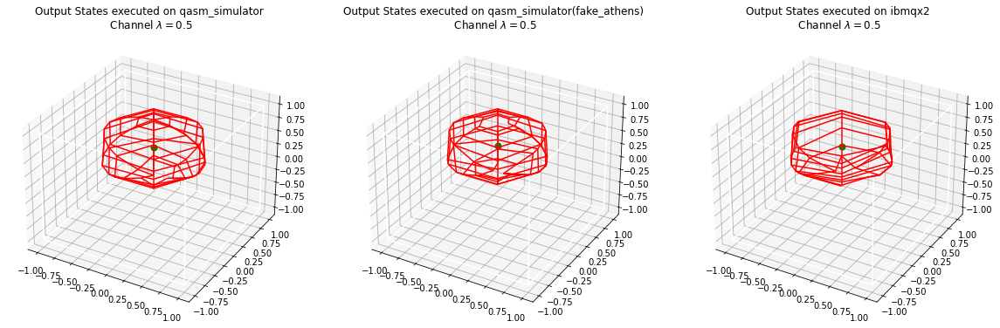

ibmqfactory.load_account:WARNING:2021-04-20 22:48:38,585: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=fe1fd624-5c7c-453f-8036-87bd8532b79c
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=b50eac08-fa6d-40d7-b37a-1c5ec27f5252
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3e49088c803c870b0304


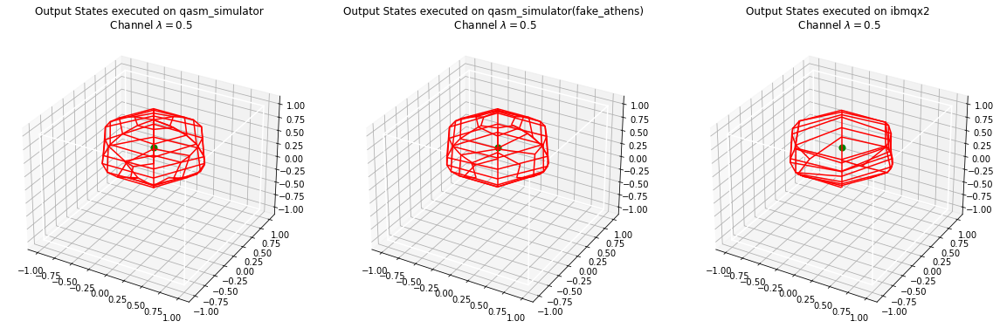

ibmqfactory.load_account:WARNING:2021-04-20 22:49:46,341: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=d91a1ba8-a86f-4a6f-8cb6-de5f152bf06b
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=c610f55d-2a14-4c62-bcd2-535dc36ba572
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3e8e045f6c45c9fdd59d


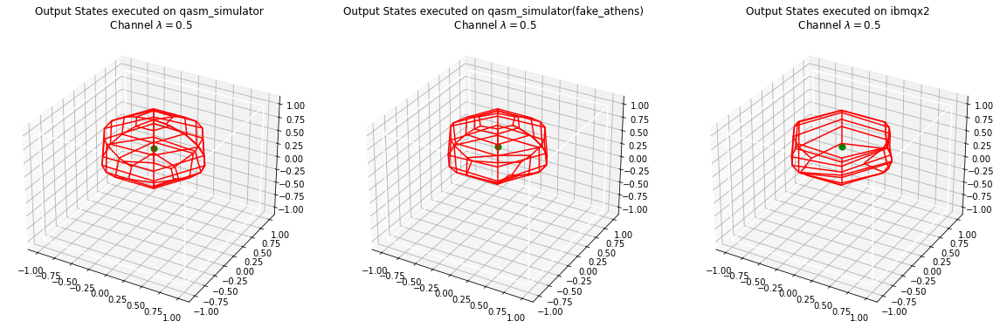

ibmqfactory.load_account:WARNING:2021-04-20 22:50:54,981: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=38563a24-4056-466d-8fcc-d83eae62428f
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=52d9d2cc-7b5e-4d21-a21e-c3672b816002
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3ed2045f6c69a1fdd59f


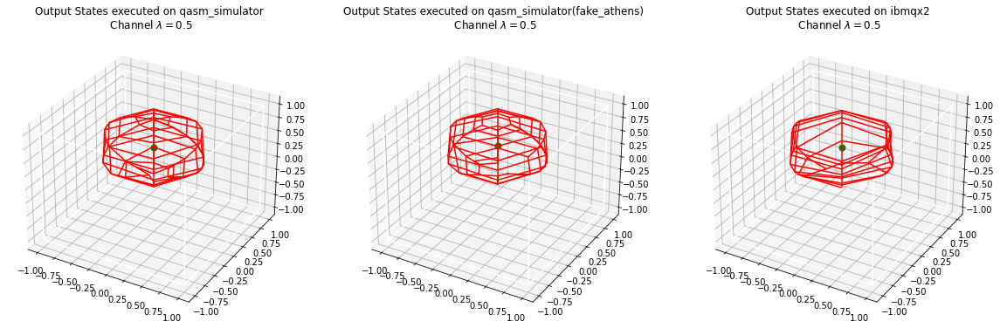

ibmqfactory.load_account:WARNING:2021-04-20 22:52:03,688: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=e2e39be9-8403-42dd-a240-8ba0eb5c4a2e
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=155feb90-0b03-467c-8100-84d4e179cc0f
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3f17adaee24e6076d3b5


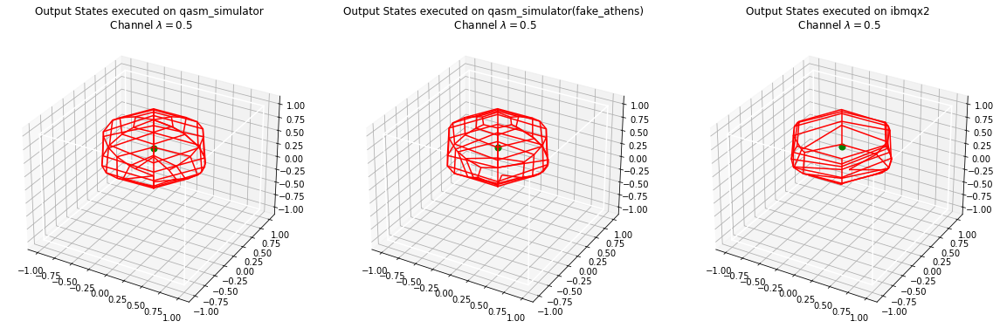

ibmqfactory.load_account:WARNING:2021-04-20 22:53:11,987: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=f45e594a-7b29-4084-aa21-bf09027fde9a
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=e763c8e6-9315-48da-8412-e406de5c0fd6
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3f5c045f6cdb2dfdd5a5


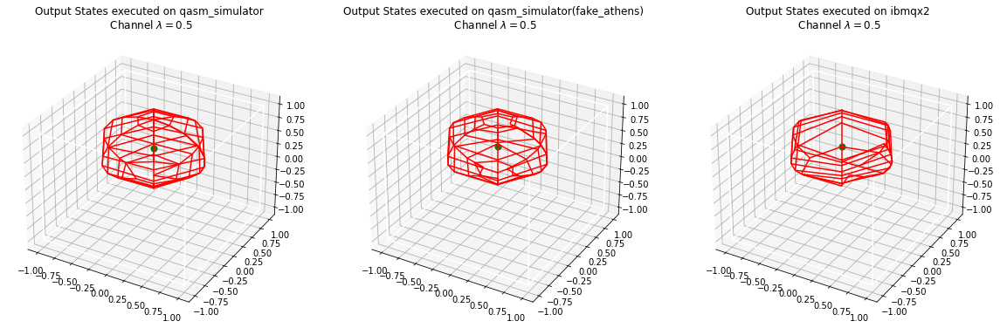

ibmqfactory.load_account:WARNING:2021-04-20 22:54:24,588: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=f6bff38c-b1f0-4a0b-9546-09ac32a450d4
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2f75cdbb-28b6-44d2-8a78-b931fc16ed2e
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3fa4088c803bdf0b030f


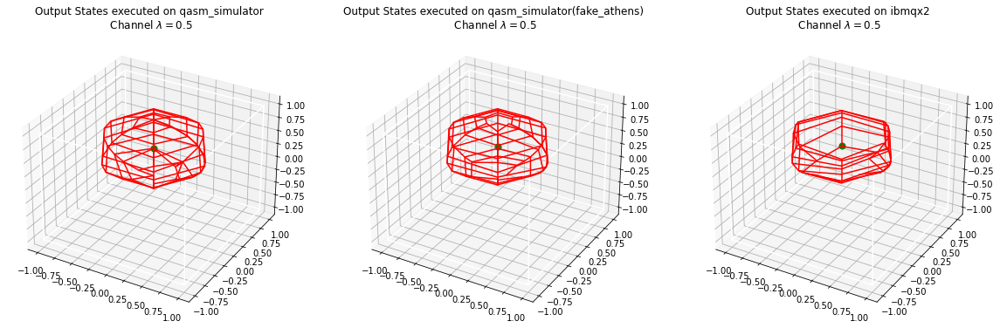

ibmqfactory.load_account:WARNING:2021-04-20 22:55:33,707: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=0fe66595-c034-43bb-8923-a730de02e2ed
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=16d04116-d6ea-4d86-85ac-5bf256fce457
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f3fe8667b24fe3fcfb37b


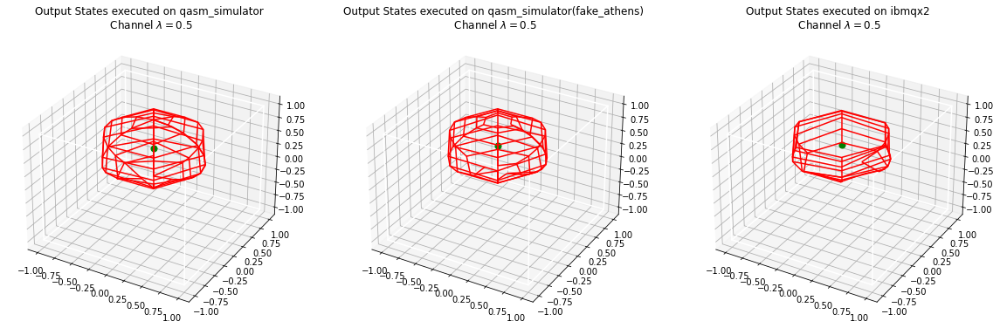

ibmqfactory.load_account:WARNING:2021-04-20 22:56:41,322: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=720d369c-cca4-48dc-aac5-bebad47a903c
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=e7503520-c5c4-4238-ae10-ec048e157468
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4032667b24da7bcfb37d


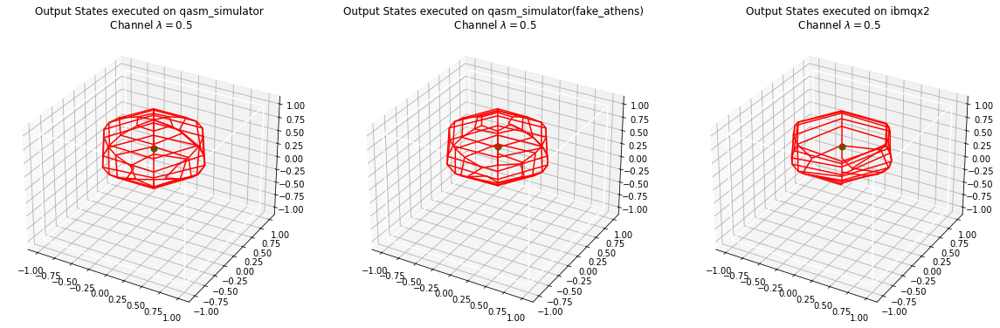

ibmqfactory.load_account:WARNING:2021-04-20 22:57:54,677: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=c4945223-2261-4e4e-90d5-e68d662869db
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=b74fe61b-08ff-47bd-a9f5-5613911e9cc4
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f407ac41c144e8da9e8f8


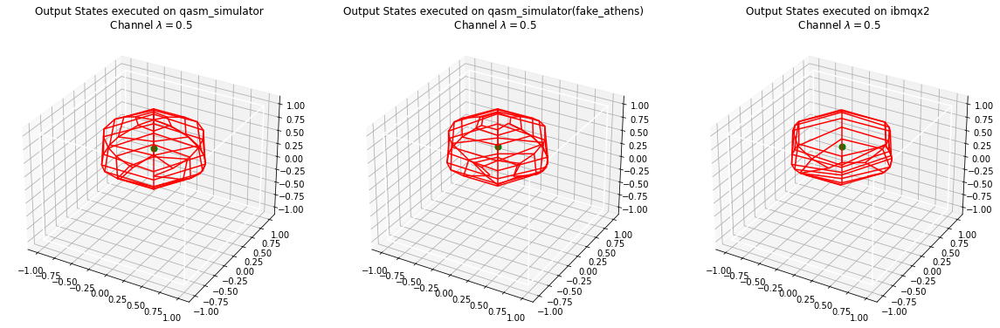

ibmqfactory.load_account:WARNING:2021-04-20 22:59:07,003: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=9c5268a6-acd2-4d61-8d55-36e8114ec62e
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=b5739c27-dbb0-4c7b-88c6-53bacac60637
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f40bf3bca0b25563794b0


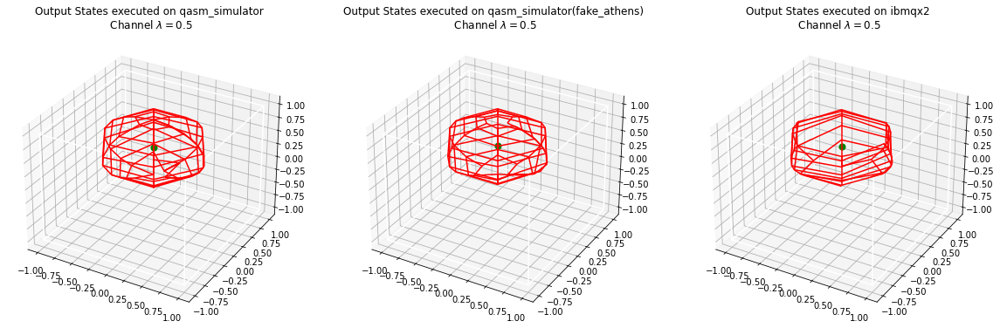

ibmqfactory.load_account:WARNING:2021-04-20 23:00:16,838: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=6aacf1f6-c587-403e-b69e-76a5fdf8ab68
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=ded8e2d6-2092-43ae-bb3e-76143722f8b4
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4103088c80579d0b031e


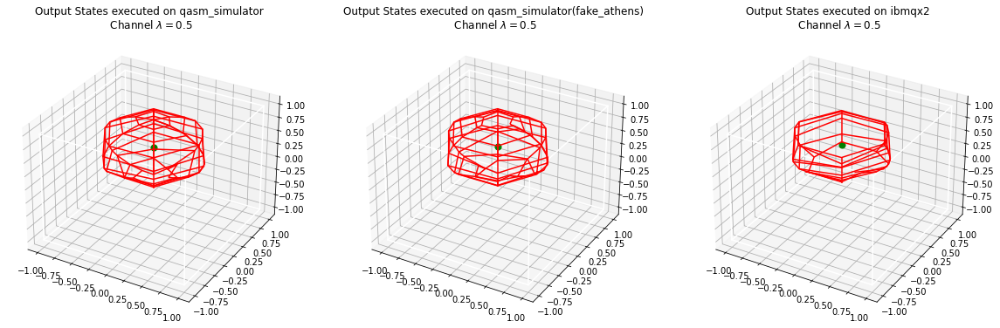

ibmqfactory.load_account:WARNING:2021-04-20 23:01:24,070: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=f5bf68cf-1d2b-4e2a-8fb8-600074c074ed
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=b3cb8b48-de9f-4742-a93a-8df9820104b0
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f4148d2bccb827400c98a


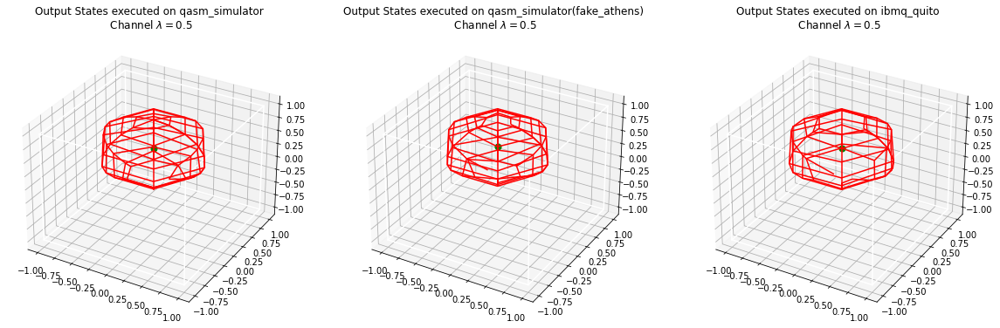

ibmqfactory.load_account:WARNING:2021-04-20 23:02:34,795: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=0139d603-04a5-48b7-b9c3-fd8e901d5082
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=99f16ea8-0939-465b-a16c-ca05d090ad43
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f418d667b2406cecfb390


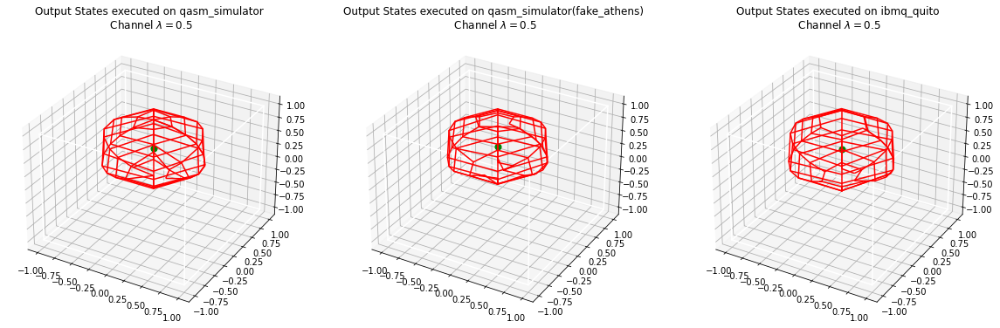

ibmqfactory.load_account:WARNING:2021-04-20 23:04:27,806: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=18a21a07-7096-468d-ba0c-98b1067060e1
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=c291326f-1011-496c-baaf-f6499d15bf67
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f420413b2446690c01a99


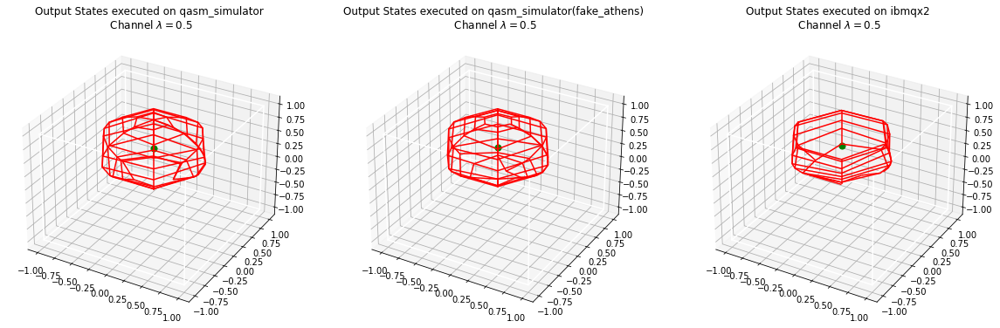

ibmqfactory.load_account:WARNING:2021-04-20 23:15:33,963: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=98f9cc49-1b28-4658-b6d7-e349d6164fd3
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=c130b349-45fe-468e-862f-4c3fda5d9dd4
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f449f088c8070480b0342


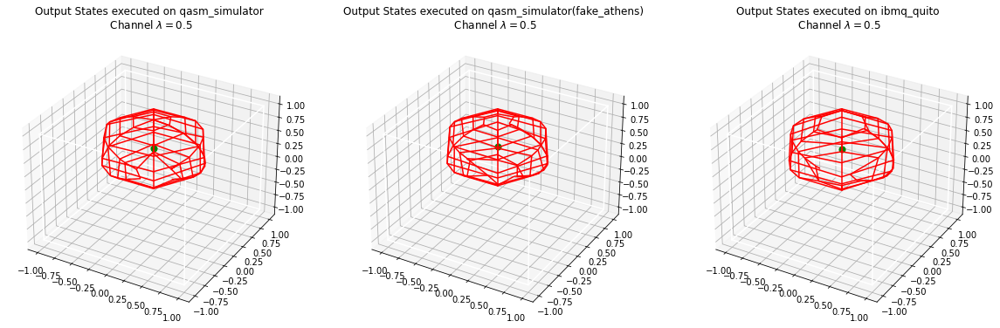

ibmqfactory.load_account:WARNING:2021-04-20 23:17:40,658: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=b35ecb71-e661-4c6d-8a91-a1fa9068b3aa
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=51199f3a-ad39-47a1-9023-7414fb1a3fd6
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f451b88bc93120207b662


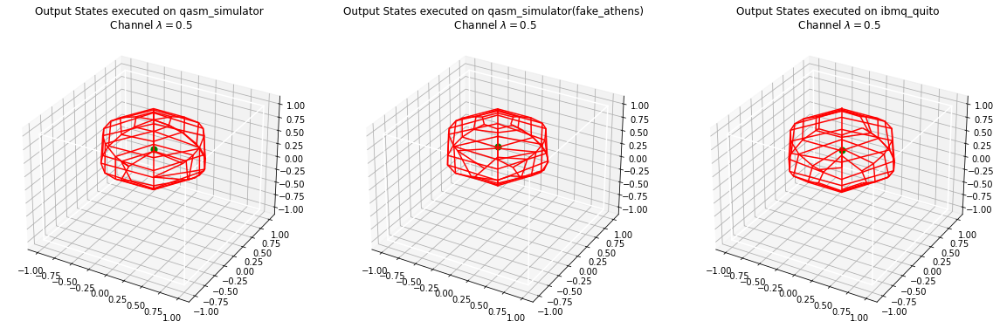

ibmqfactory.load_account:WARNING:2021-04-20 23:18:54,181: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=5543278a-dd0a-4a37-bb0a-b26cd0f03eba
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=6ee12663-0d4d-49a2-931b-f5e3b007e7aa
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f456188bc93405107b665


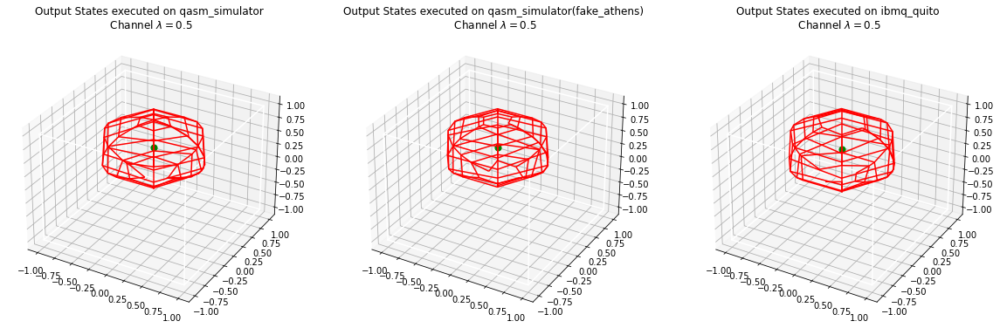

ibmqfactory.load_account:WARNING:2021-04-20 23:20:03,128: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmq_quito
Execution using channel with λ=0.5 launched to qasm_simulator with id=8985a586-94a0-40f9-b34e-a6cd2b982d4b
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=8a8e0223-bac0-41b2-b585-a09db8945834
Execution using channel with λ=0.5 launched to ibmq_quito with id=607f45a513b2448c4ec01ab6


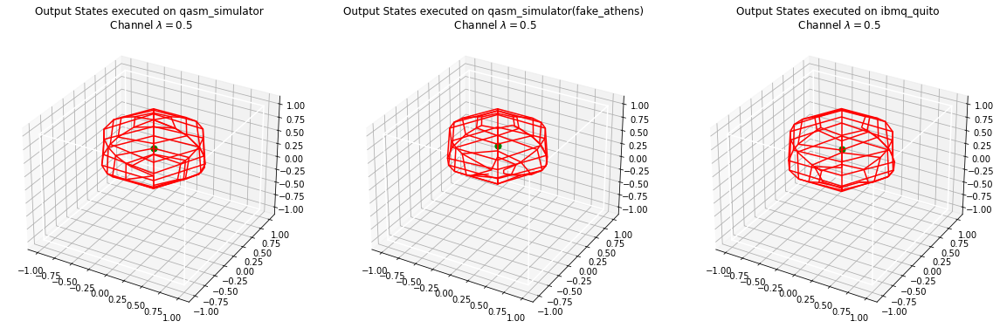

ibmqfactory.load_account:WARNING:2021-04-20 23:22:52,284: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=9b1b5cf8-5671-4591-92c5-a2e58d882aab
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2a666ace-0180-4e2f-a55e-21e94e18a4b4
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4650d2bccb1d1100c9b1


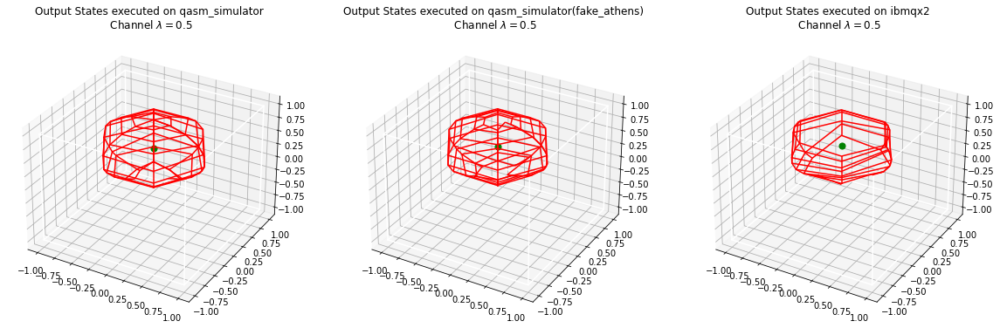

ibmqfactory.load_account:WARNING:2021-04-20 23:29:44,004: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=f9db6a88-5c47-4f5e-803a-a2d5169d9de3
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=60f2d66f-8222-44e3-99b0-323a58cc7f1c
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f47eb045f6c361efdd5f0


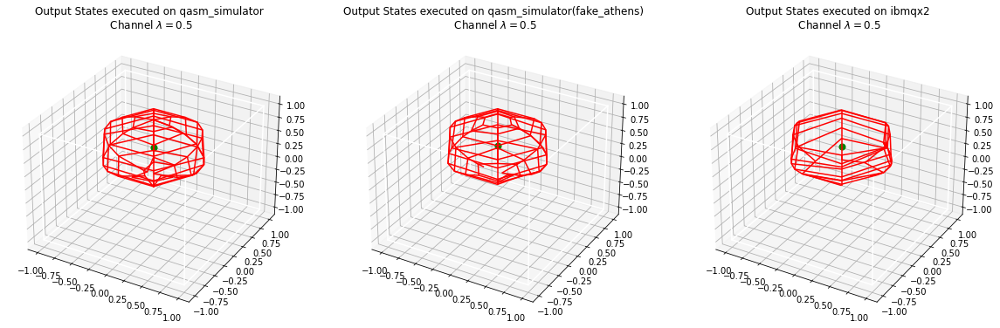

ibmqfactory.load_account:WARNING:2021-04-20 23:30:51,162: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=922fd5f5-9bb5-48ea-b636-af5ceab22055
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=330cd6ee-bf72-4cc5-b48f-29ca94f06495
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4830c41c14c48aa9e941


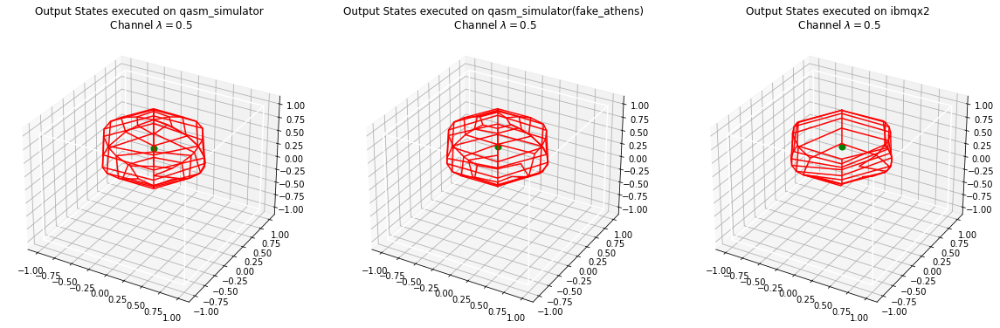

ibmqfactory.load_account:WARNING:2021-04-20 23:36:57,674: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=0a62e7c0-6444-4fdd-94b7-907e8c122b83
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=8d3fe36a-6ffd-48b5-9171-e84d08e1f557
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f499d88bc93f39707b689


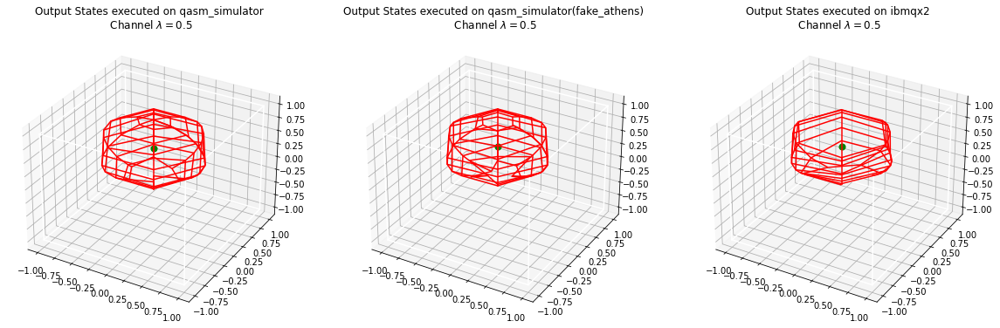

ibmqfactory.load_account:WARNING:2021-04-20 23:46:24,317: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=315b45f0-7d60-4d5c-952d-df5f95dcdea5
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2052bfe6-31f4-4260-ae30-0539fcc2c599
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4bd3045f6c66b2fdd614


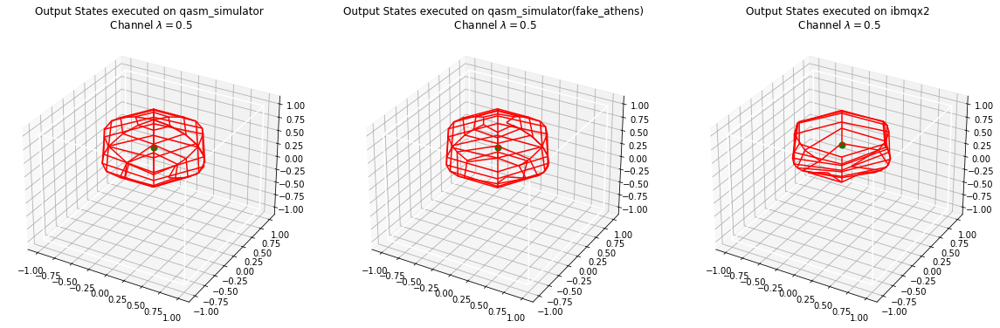

ibmqfactory.load_account:WARNING:2021-04-20 23:47:31,862: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=d0eff3ab-f1e3-41bf-b882-56b523a63d91
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=98078f47-47be-4620-9362-a0a8bd84195f
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4c1888bc9329c407b69b


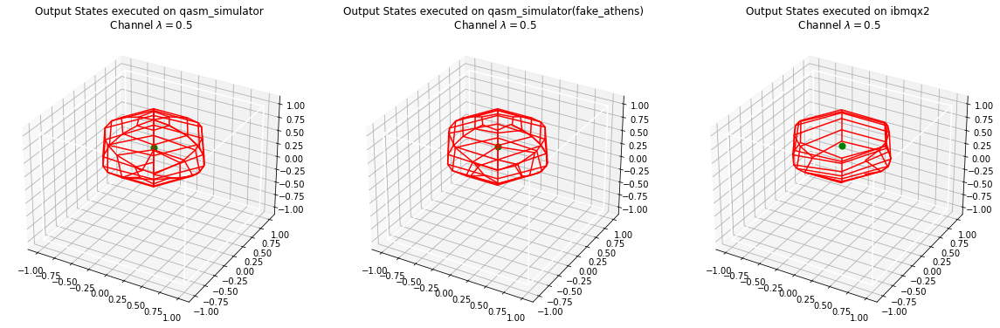

ibmqfactory.load_account:WARNING:2021-04-20 23:48:40,860: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=fce7701f-85ac-43bb-85f2-3329c7960fdb
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=c98c5d34-deec-4266-a8ae-67aaa303e148
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4c5bd2bccb444200c9e5


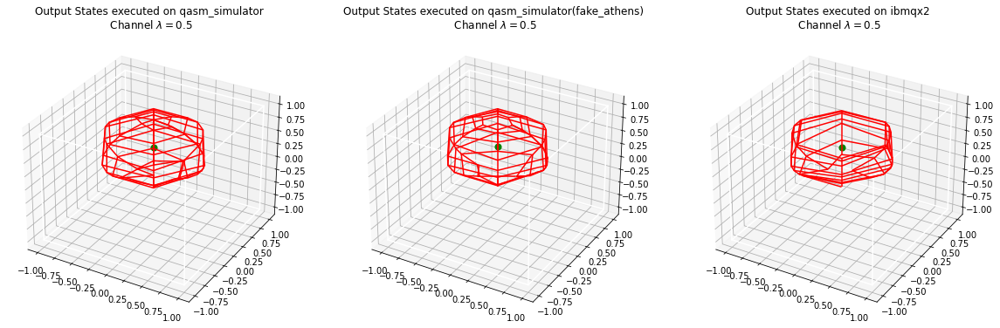

ibmqfactory.load_account:WARNING:2021-04-20 23:49:48,088: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=da5f3d61-3f72-40e7-bce3-a781c388fe7e
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=e2e741d6-1cc8-47ae-a9e5-10dcf86aa584
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4ca6045f6cb5bffdd61a


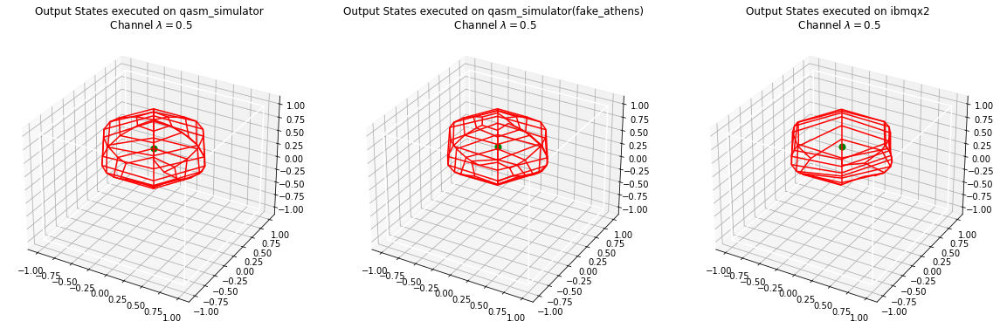

ibmqfactory.load_account:WARNING:2021-04-20 23:51:02,309: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=08a0aabe-09ef-468e-a3e2-850673c04777
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=0891f49e-edd6-4102-9cec-d8a1d4aed854
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4ceac41c1419a8a9e96b


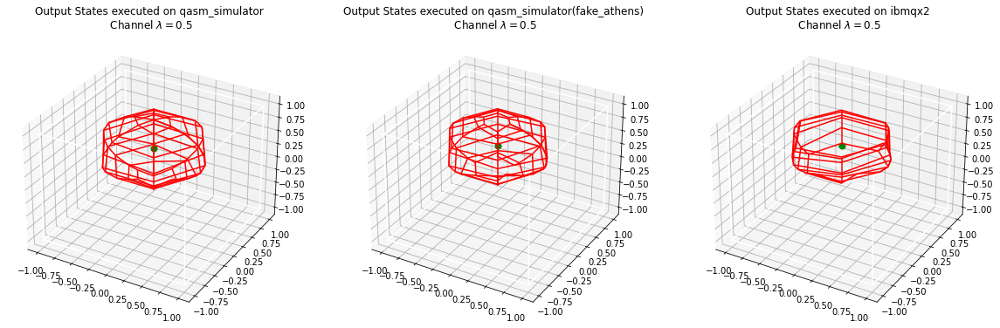

ibmqfactory.load_account:WARNING:2021-04-20 23:52:16,330: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=3096e218-b0ce-4efc-80c2-a49c54f29698
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=ce130d62-6778-448d-91b2-2e7a665760f0
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4d32667b243bc1cfb3ee


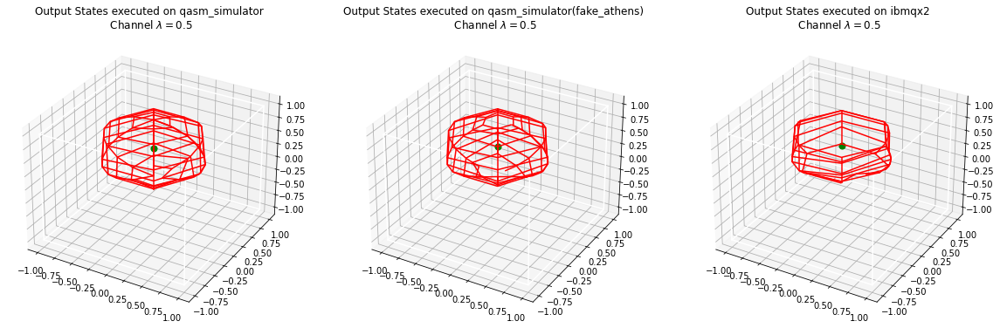

ibmqfactory.load_account:WARNING:2021-04-20 23:53:23,070: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=9946f400-7583-4f92-a1a5-acace952299b
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=3664afe9-d015-4391-9841-b446d840cede
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4d7513b24428cdc01af5


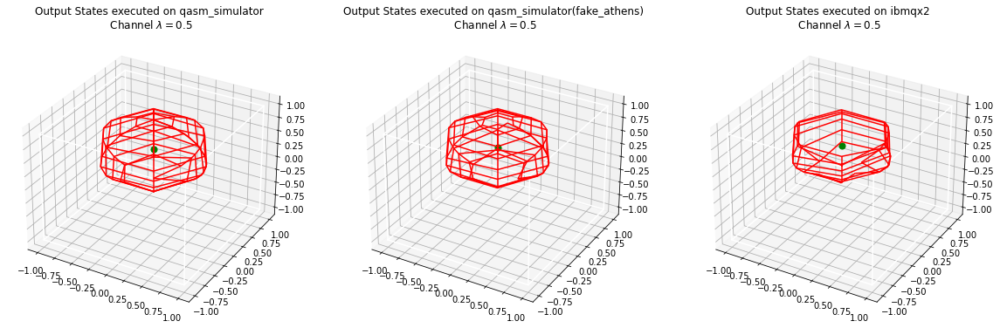

ibmqfactory.load_account:WARNING:2021-04-20 23:54:30,586: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=c726ca9d-bfc5-404f-b4a1-70ff845f6dbc
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=77ae7fe0-6e24-463a-b07b-5cf16d29793e
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4dba3bca0b063f37951d


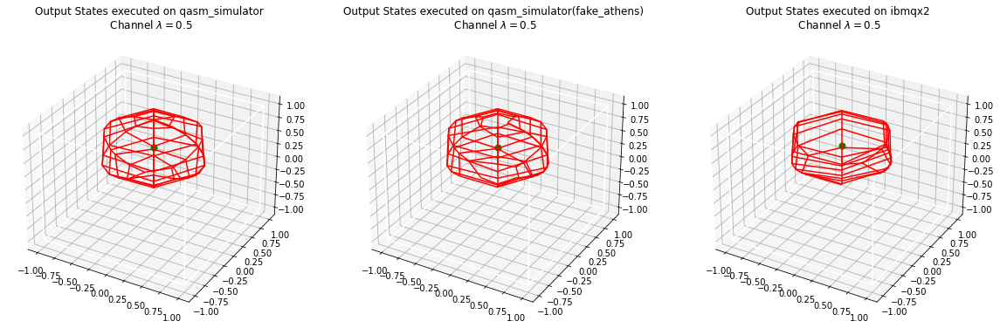

ibmqfactory.load_account:WARNING:2021-04-21 00:01:02,907: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=75d4daa5-08d6-4464-afe5-610823049a37
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=eabec799-6637-4ec6-95aa-5d19b9557784
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f4f4a13b244898fc01b05


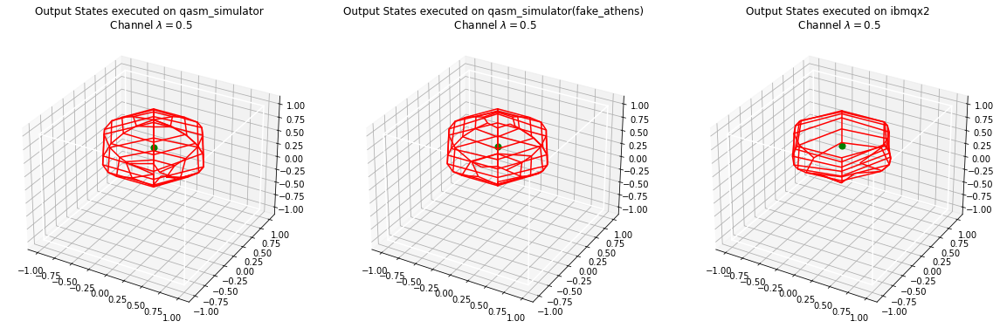

ibmqfactory.load_account:WARNING:2021-04-21 00:04:13,478: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=46d0af4f-e88a-41b7-81ed-3a380af087cf
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=c2680e85-ae7f-4788-90ce-362173adb845
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f5005c41c144ffba9e983


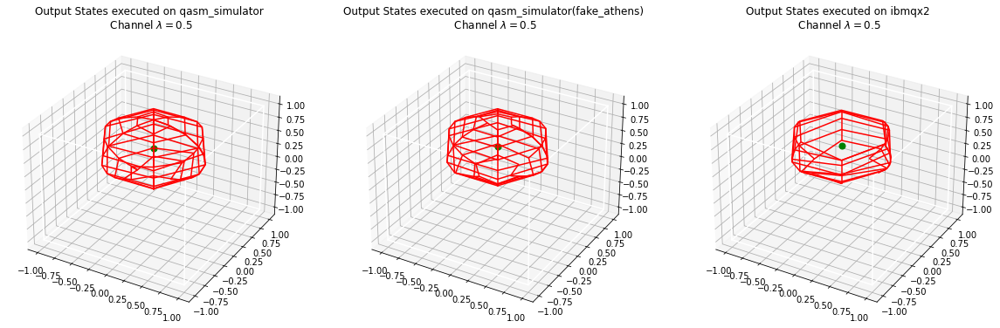

ibmqfactory.load_account:WARNING:2021-04-21 00:05:27,615: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=8f6f3a09-5775-474a-bef9-1fb58e610c60
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=e03ffae4-d46c-4b3f-ad1c-a4032521d221
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f504b13b24459c2c01b0d


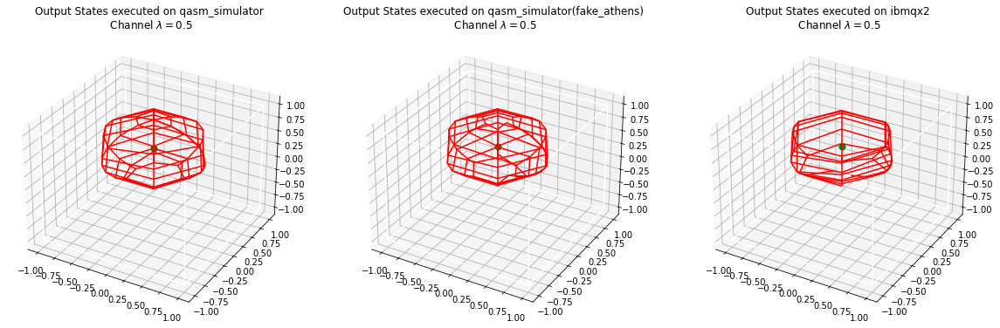

ibmqfactory.load_account:WARNING:2021-04-21 00:06:36,529: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=5dbd3777-ccc5-4046-a7e9-e073242d7185
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=796c309f-e760-4c6d-bb5c-a7618650b10f
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f5090045f6c678afdd643


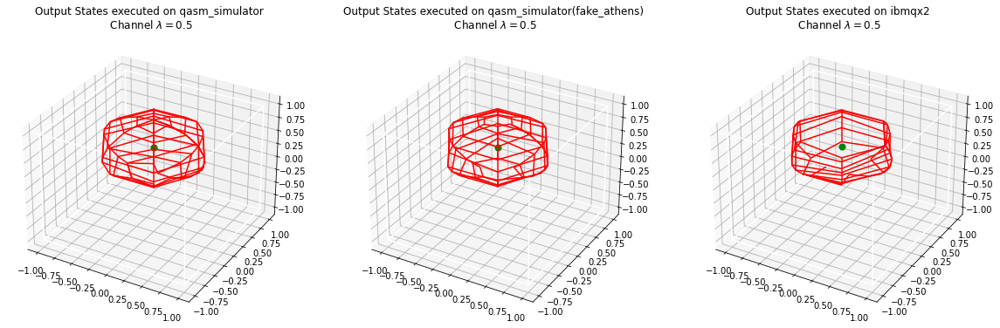

ibmqfactory.load_account:WARNING:2021-04-21 00:07:47,318: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=1dc3d412-74dd-494c-956b-bf0dfd500d12
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2c6bb4b0-544b-40b3-8bf0-739979080da2
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f50d7adaee27fd976d440


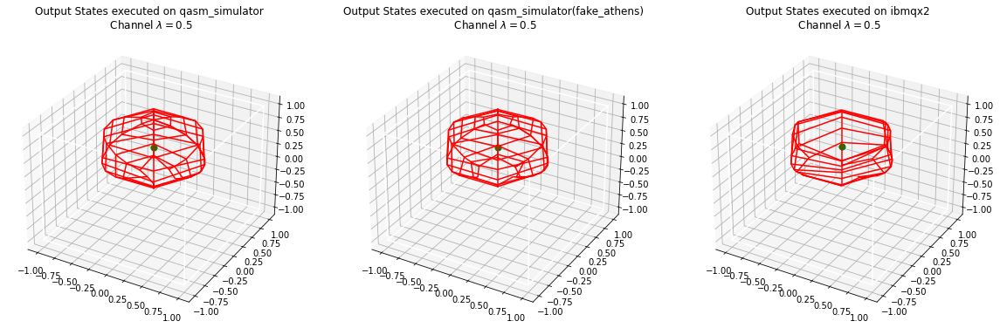

ibmqfactory.load_account:WARNING:2021-04-21 00:08:58,825: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=1eb21655-1688-488b-93a4-797a6ad25a34
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=690cdd02-d34b-4a25-b305-059c5ea5ca58
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f511d045f6c5cbbfdd649


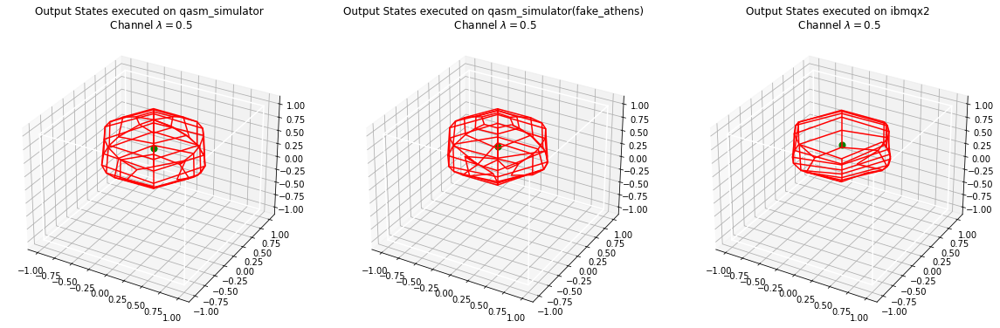

ibmqfactory.load_account:WARNING:2021-04-21 00:10:09,533: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=31764c12-8c81-4689-8eb0-82d15a8ae1dc
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=d16dbfb4-783f-4451-baad-b74707c0161e
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f516913b2441d2ac01b17


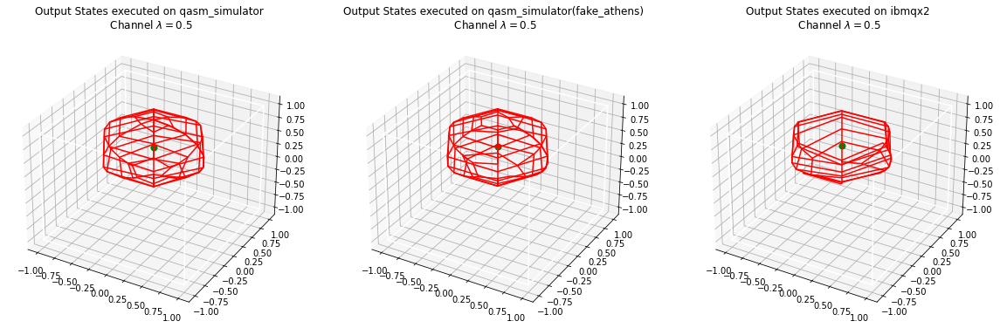

ibmqfactory.load_account:WARNING:2021-04-21 00:11:21,708: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=81d89bc3-9ba4-4abb-bfda-8c44fc98c46c
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=951bd009-1711-40f8-8786-2096a8222a10
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f51ac63b1073666b57c8f


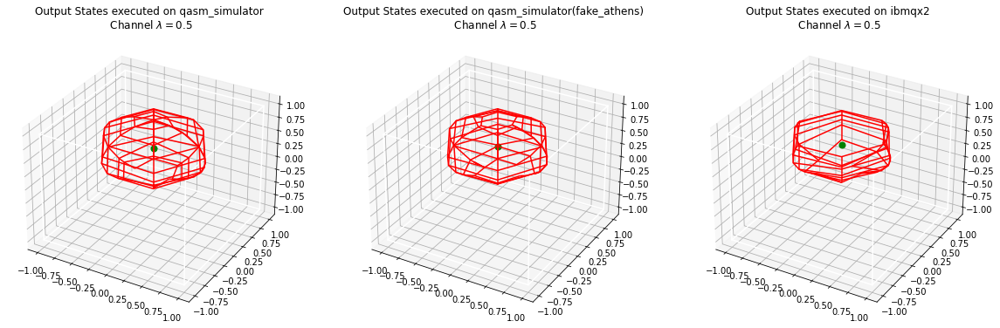

ibmqfactory.load_account:WARNING:2021-04-21 00:12:28,940: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=8719dde2-d84c-4ee3-abf1-95d9f7767fcb
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=56495cda-5575-4d82-be43-b3316923d433
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f51f23bca0b3747379540


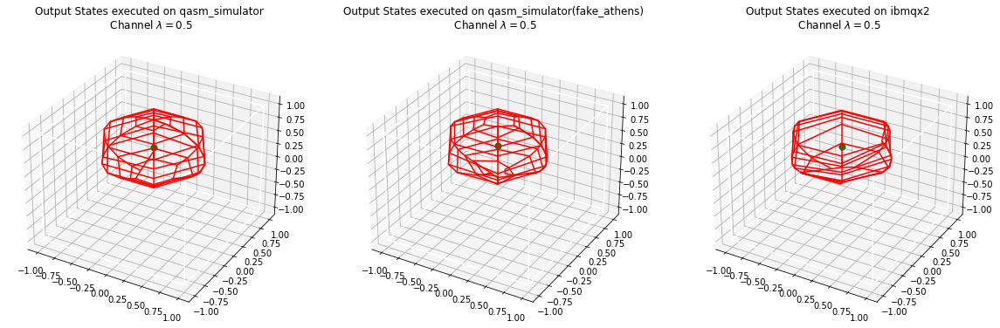

ibmqfactory.load_account:WARNING:2021-04-21 00:13:38,636: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=36a33b78-5707-47c9-8504-7fc9d9321264
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=a70898ac-c857-4c45-817a-2808531a4ca0
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f5235c41c14a3a3a9e995


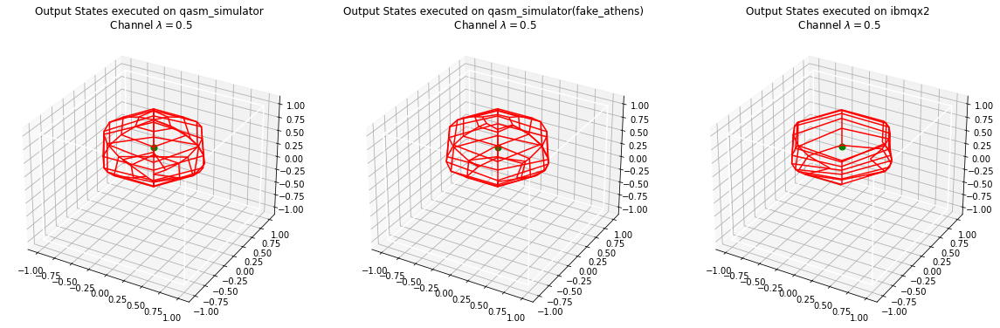

ibmqfactory.load_account:WARNING:2021-04-21 00:14:45,941: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=7f1f860c-84a3-4e35-a9fd-933873cf3dc9
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=bb5f400b-9562-4f21-a384-f2cedeb50439
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f5277c41c14020ba9e998


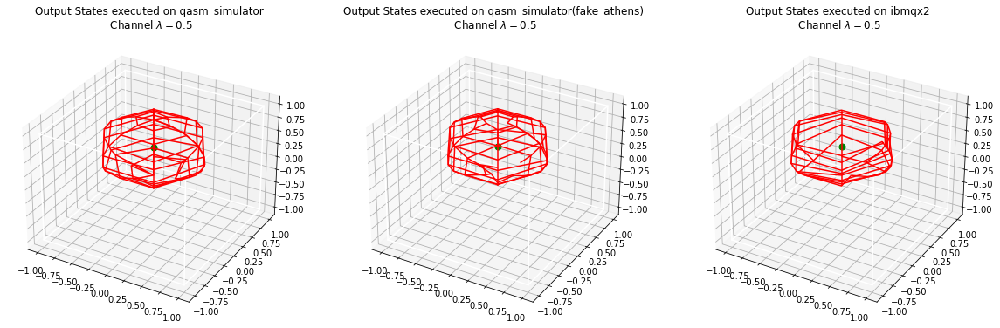

ibmqfactory.load_account:WARNING:2021-04-21 00:15:52,296: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=98548105-eaf4-49d7-8969-de5d00d852a8
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=59ecf3f3-75e7-403e-9a32-67eeb811c1bc
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f52baadaee24fbb76d450


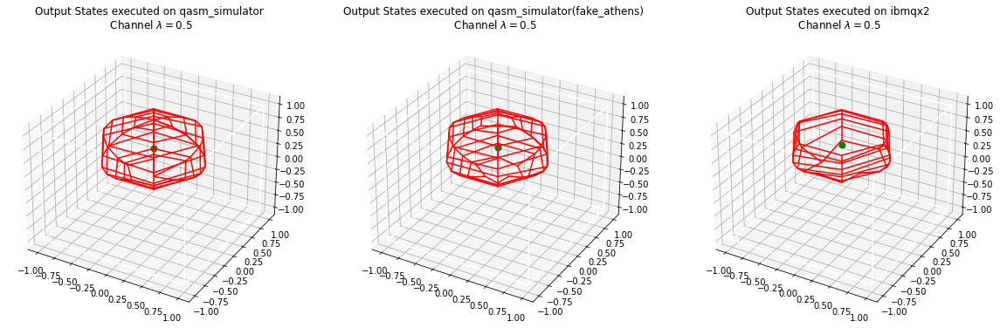

ibmqfactory.load_account:WARNING:2021-04-21 00:16:58,681: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=dd61b3d8-a425-4388-91c2-1f2cf3b9a937
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=8225ece3-6f8d-41c0-99a9-40967bc7d6bd
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f5302667b24f290cfb423


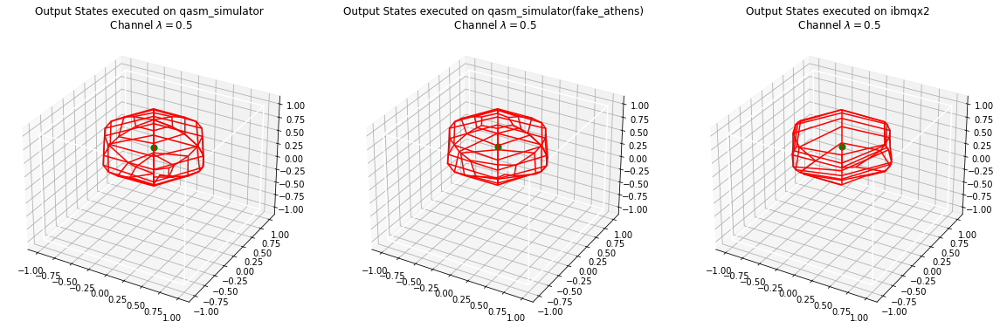

ibmqfactory.load_account:WARNING:2021-04-21 00:18:11,329: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=bb3ee78b-a1ef-4427-9868-8d83a70c689c
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=87715d66-51ae-4c6e-80ba-8224a9640ac4
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f534bc41c14c814a9e99d


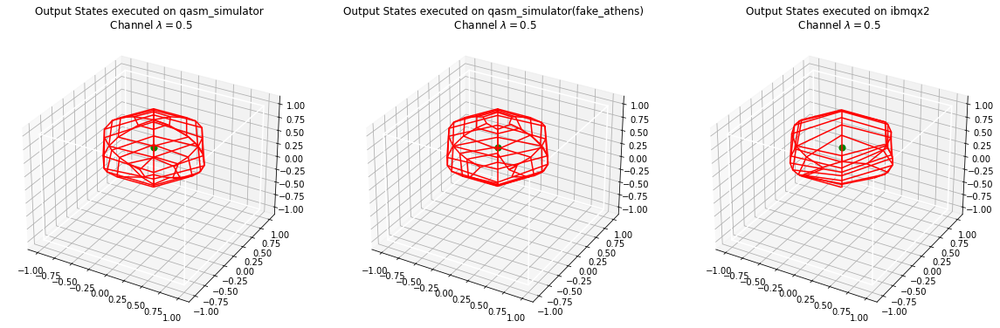

ibmqfactory.load_account:WARNING:2021-04-21 00:19:25,019: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=59f2f7e7-b28a-4b43-ab50-d955a1f5c9d5
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=5f31c410-ff8d-4c1d-8f1d-fd66d30a983c
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f539363b107d353b57ca0


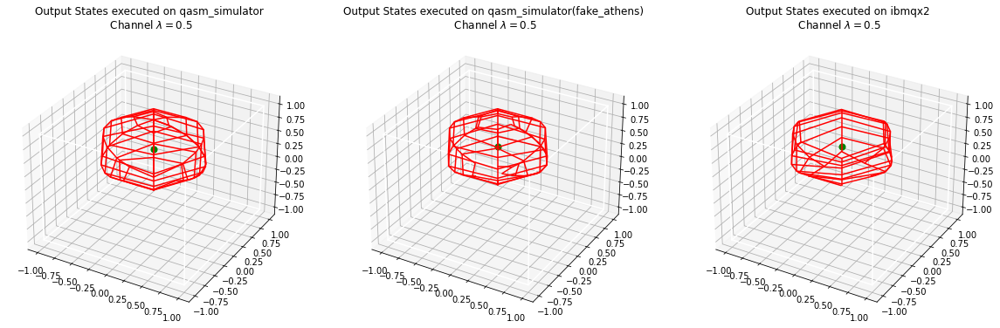

ibmqfactory.load_account:WARNING:2021-04-21 00:20:36,452: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=22024889-d6ee-4167-a062-58e4fbe80932
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=c7c9f7f2-f81c-4d06-8dac-f2d9dc408609
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f53d863b1077152b57ca4


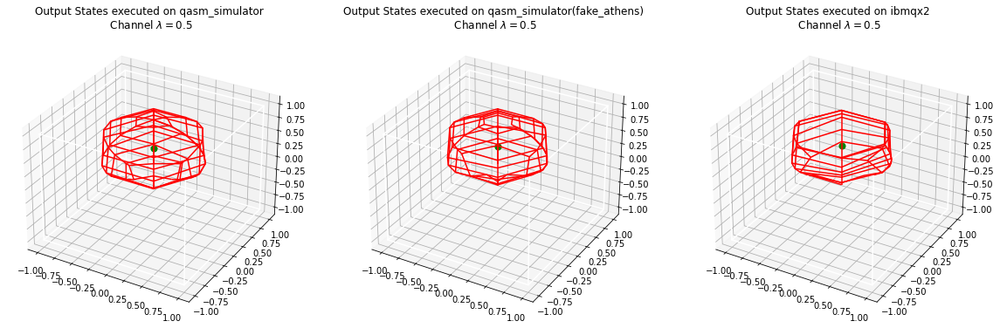

ibmqfactory.load_account:WARNING:2021-04-21 00:21:44,550: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=537d0f10-8c5d-489a-89e7-475e3deb7754
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2af0132a-e504-4654-a2f0-fc011fe7b4aa
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f541b88bc93624007b6d7


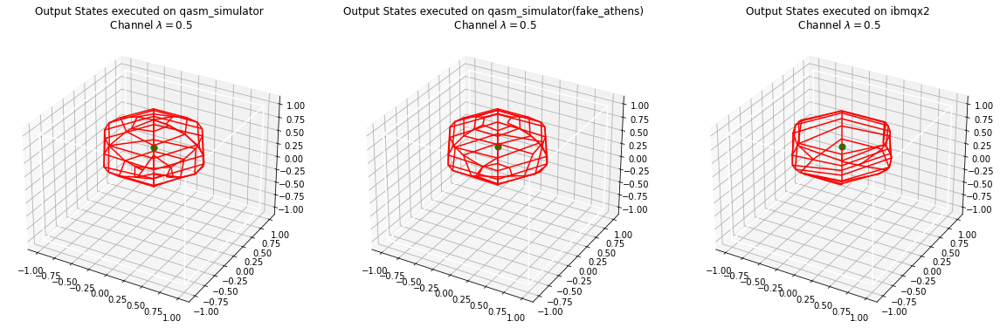

ibmqfactory.load_account:WARNING:2021-04-21 00:22:51,069: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=f89f6982-299d-4071-b25d-82afd07563bb
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2300f3c8-3379-4f9a-8883-b01fce96de9f
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f545f088c8082270b03bf


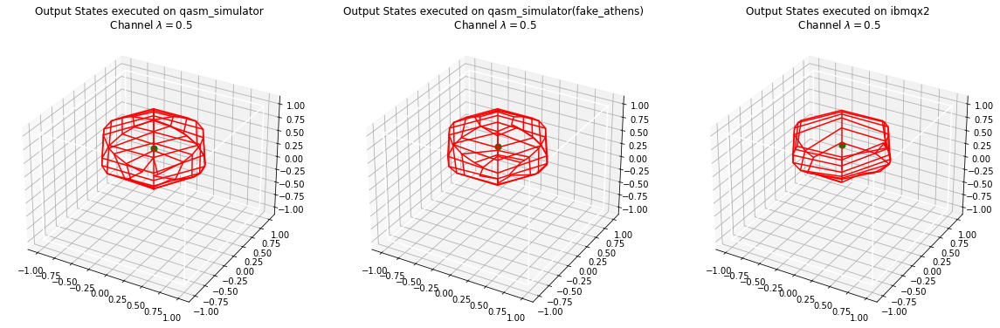

ibmqfactory.load_account:WARNING:2021-04-21 00:24:00,319: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=112cb732-2433-4c0c-ac98-cf3d0779b06b
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=d1653181-88fb-476b-a90e-11e67c8ab37e
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f54a5c41c144a9ba9e9a8


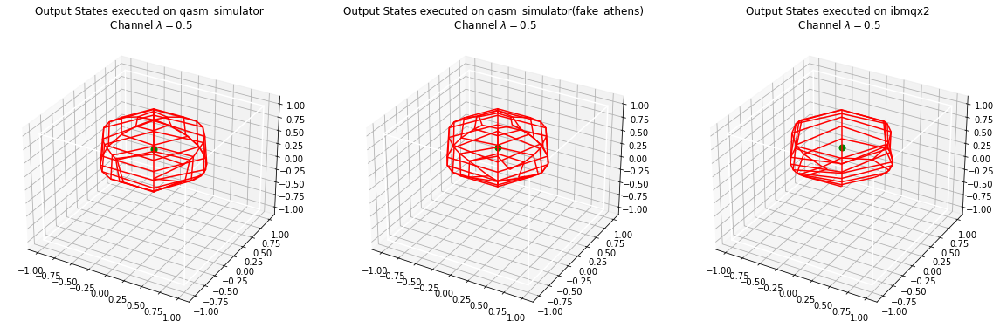

ibmqfactory.load_account:WARNING:2021-04-21 00:25:10,715: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=5e48941f-0b60-4f3d-8654-847a8d763463
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=54718803-7a26-4ecb-a26c-9e1e738dd195
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f54eb3bca0b1192379561


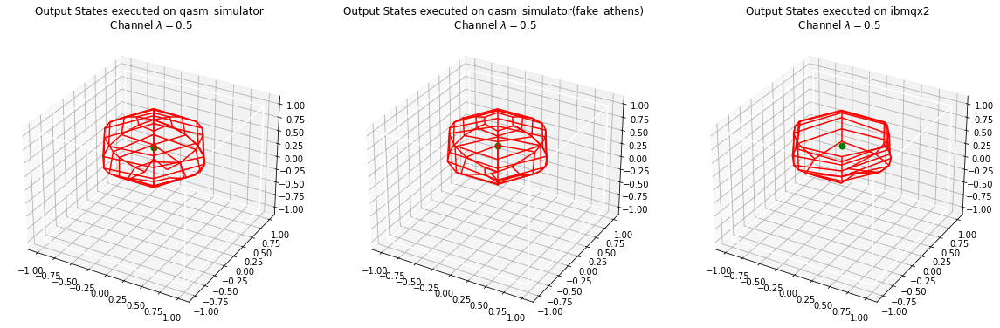

ibmqfactory.load_account:WARNING:2021-04-21 00:26:19,526: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=64835e3f-214d-4de1-9aa4-ca00d6d30507
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=599b1f88-4f63-4ebd-85ff-20c13e87801f
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f552f88bc93aa9607b6e3


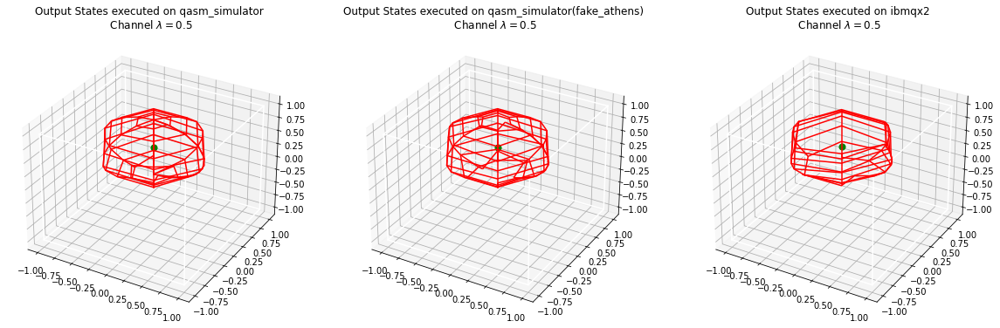

ibmqfactory.load_account:WARNING:2021-04-21 00:27:27,149: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=fe3247d2-356b-46e0-b0ad-1a4ca7437473
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=9f424536-3495-42d0-80ef-dbc86e22b2ba
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f5571d2bccb802400ca31


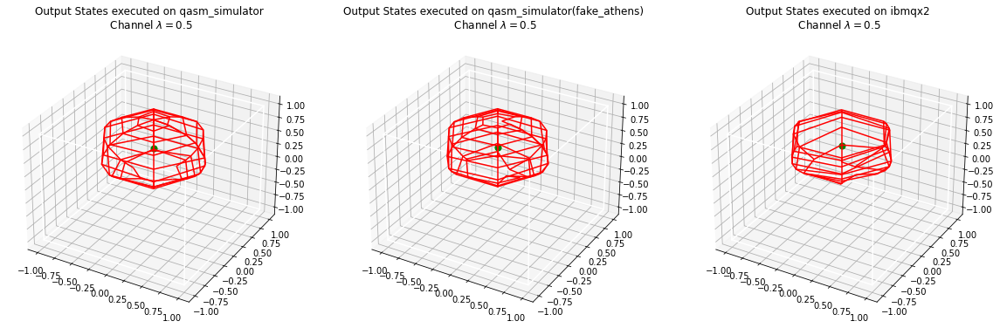

ibmqfactory.load_account:WARNING:2021-04-21 00:28:33,770: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=c015a54e-fd1b-4961-bf78-309dd2eab749
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=2ddcdc0e-1e83-4273-bbd5-b8ee31f7aac0
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f55b4045f6c605afdd66f


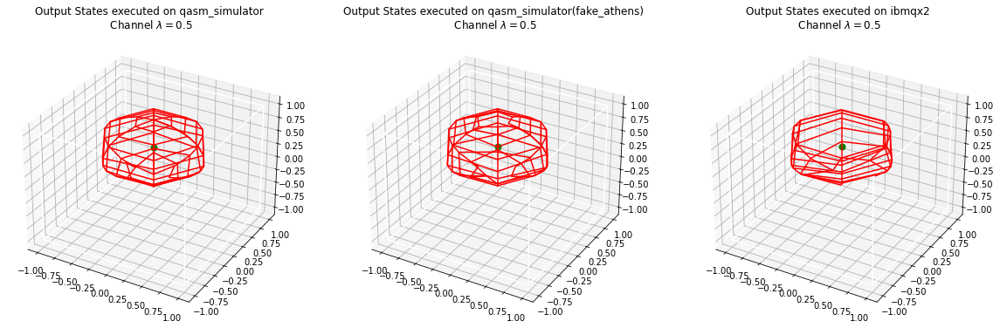

ibmqfactory.load_account:WARNING:2021-04-21 00:29:46,251: Credentials are already in use. The existing account in the session will be replaced.


Running on current least busy device:  ibmqx2
Execution using channel with λ=0.5 launched to qasm_simulator with id=ac95dcbb-0381-476b-847a-49e8140c85cd
Execution using channel with λ=0.5 launched to qasm_simulator(fake_athens) with id=31563f7e-7c18-46d4-b4a7-6cfb572a57e6
Execution using channel with λ=0.5 launched to ibmqx2 with id=607f55fe88bc93cbf407b6ed


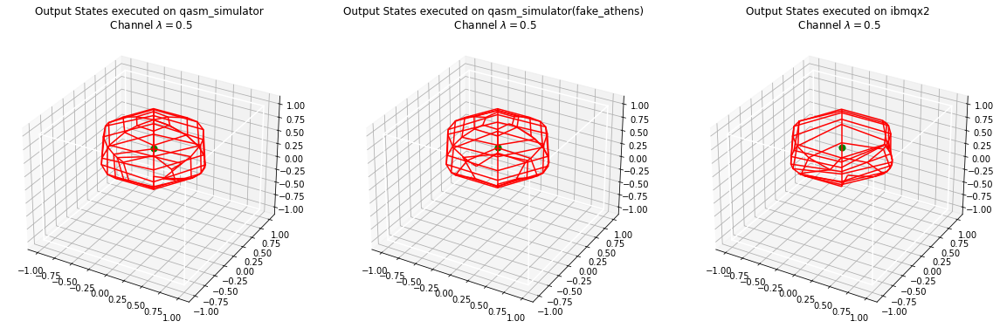

In [21]:
for idx in range(100):
    run_three_executions(idx)